# Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks

## Import libraries and packages

In [1]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os

# Add TF GPU for Jetson TX2
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
config.gpu_options.per_process_gpu_memory_fraction = 0.8
session = tf.Session(config=config)

#%matplotlib inline

# tf.__version__, tf.test.is_gpu_available(), tf.test.is_built_with_cuda(), tf.test.gpu_device_name()

## Import data set

In [2]:
data_dir = 'data'
# print(os.listdir(os.path.join(data_dir, 'cirrocumulus', '*.jpg')))

In [3]:
image_dir = os.path.join(data_dir, 'cirrocumulus', '*.jpg')
print(image_dir)

data/cirrocumulus/*.jpg


In [4]:
def _img_string_to_tensor(image_string, image_size=(40, 40)):
    image_decoded = tf.image.decode_jpeg(image_string, channels=3)
    # Convert from full range of uint8 to range [0,1] of float32.
    image_decoded_as_float = tf.image.convert_image_dtype(image_decoded, dtype=tf.float32)
    # Resize to expected
    image_resized = tf.image.resize_images(image_decoded_as_float, size=image_size)
    
    return image_resized

def make_input_fn(file_pattern, image_size=(40, 40), shuffle=False, batch_size=64, num_epochs=None, buffer_size=4096):
    
    def _path_to_img(path):
        # Get the parent folder of this file to get it's class name
        label = tf.string_split([path], delimiter='/').values[-2]
        print(path)
        # Read in the image from disk
        image_string = tf.read_file(path)
        image_resized = _img_string_to_tensor(image_string, image_size)
        
        return image_resized, label
    
    def _input_fn():
        
        dataset = tf.data.Dataset.list_files(file_pattern)

        if shuffle:
            dataset = dataset.apply(tf.contrib.data.shuffle_and_repeat(buffer_size, num_epochs))
        else:
            dataset = dataset.repeat(num_epochs)

        dataset = dataset.map(_path_to_img, num_parallel_calls=os.cpu_count())
        dataset = dataset.batch(batch_size).prefetch(buffer_size)

        return dataset
    
    dataset = _input_fn()

    return dataset

## Define Parameters

### Define training parameters

In [5]:
num_steps = 100000
batch_size = 4

### Create dataset

In [6]:
dataset = make_input_fn(image_dir, image_size=(64,64), batch_size=batch_size, shuffle=True)
print(dataset)
iterator = dataset.make_initializable_iterator()
next_element = iterator.get_next()

Tensor("arg0:0", shape=(), dtype=string)
<PrefetchDataset shapes: ((?, 64, 64, 3), (?,)), types: (tf.float32, tf.string)>


### Define DCGAN network parameters

In [7]:
# dim_image = 2352 # 28 * 28 * 3
# gen_hidden_dim = 256
# dis_hidden_dim = 256
n_noise = 100

In [8]:
# keep_prob= tf.placeholder(dtype=tf.float32, name='keep_prob')
# is_training= tf.placeholder(dtype=tf.bool, name='is_training')

## Define DCGAN functions

### Define Generator

In [9]:

def gen(x, reuse=False):
    with tf.variable_scope('Generator', reuse=reuse):
#         # TensorFlow Layers automatically create variables and calculate their
#         # shape, based on the input.
#         x = tf.layers.dense(x, units=6 * 6 * 128)
#         x = tf.nn.tanh(x)
#         # Reshape to a 4-D array of images: (batch, height, width, channels)
#         # New shape: (batch, 6, 6, 128)
#         x = tf.reshape(x, shape=[-1, 6, 6, 128])
#         # Deconvolution, image shape: (batch, 14, 14, 64)
#         x = tf.layers.conv2d_transpose(x, 64, 4, strides=2)
#         # Deconvolution, image shape: (batch, 28, 28, 1)
#         x = tf.layers.conv2d_transpose(x, 1, 2, strides=2)
#         # Apply sigmoid to clip values between 0 and 1
#         x = tf.nn.sigmoid(x)

        # TensorFlow Layers automatically create variables and calculate their
        # shape, based on the input.
        
#         '''Layer 1'''
#         x = tf.layers.dense(x, units=4*4*1024)
#         x = tf.reshape(x, shape=[-1, 4, 4, 1024])
#         x = tf.layers.batch_normalization(x, training=True)
#         x = tf.nn.leaky_relu(x, alpha=0.2)
#         print(x.shape)
        
#         '''Layer 2'''
#         x = tf.layers.conv2d_transpose(x, 512, 3, strides=2,
#                                       padding='SAME')
#         x = tf.layers.batch_normalization(x, training=True)
#         x = tf.nn.leaky_relu(x, alpha=0.2)
#         print(x.shape)
#         '''Layer 3'''
#         x = tf.layers.conv2d_transpose(x, 256, 3, strides=2,
#                                       padding='SAME')
#         x = tf.layers.batch_normalization(x, training=True)
#         x = tf.nn.leaky_relu(x, alpha=0.2)
#         print(x.shape)
#         '''Layer 4'''
#         x = tf.layers.conv2d_transpose(x, 128, 3, strides=2,
#                                       padding='SAME')
#         x = tf.layers.batch_normalization(x, training=True)
#         x = tf.nn.leaky_relu(x, alpha=0.2)
#         print(x.shape)

#         '''Layer 6'''
#         x = tf.layers.conv2d_transpose(x, 3, 2, strides=2,
#                                       padding='SAME')
#         print(x.shape)
#         x = tf.nn.tanh(x)
        
        """Layer 1"""
        x = tf.layers.dense(x, units=64*64*8)
        x = tf.nn.leaky_relu(x, alpha=0.1)
        x = tf.layers.batch_normalization(x, training=True, momentum=0.9)
        x = tf.reshape(x, shape=[-1, 64, 64, 8])
        print(x.shape)
        
        """Layer 2"""
        x = tf.layers.conv2d(x, 128, kernel_size=(5,5), strides=1, padding='SAME')
        x = tf.layers.batch_normalization(x, training=True, momentum=0.9)
        x = tf.nn.leaky_relu(x, alpha=0.1)
        print(x.shape)
        
        """Layer 3"""
        x = tf.layers.conv2d_transpose(x, 128, kernel_size=(2,2), strides=1, padding='SAME')
        x = tf.nn.leaky_relu(x, alpha=0.1)
        print(x.shape)
        
        """Layer 4"""
        x = tf.layers.conv2d(x, 128, kernel_size=(5,5), strides=1, padding='SAME')
        x = tf.layers.batch_normalization(x, training=True, momentum=0.9)
        x = tf.nn.leaky_relu(x, alpha=0.1)
        print(x.shape)
        
        """Layer 4"""
        x = tf.layers.conv2d(x, 128, kernel_size=(5,5), strides=1, padding='SAME')
        x = tf.layers.batch_normalization(x, training=True, momentum=0.9)
        x = tf.nn.leaky_relu(x, alpha=0.1)
        print(x.shape)
        
        """Layer 5"""
        x = tf.layers.conv2d(x, 3, kernel_size=(5,5), strides=1, padding='SAME')
        x = tf.nn.tanh(x)
        print(x.shape)
        return x

        

### Define discriminator

In [10]:

def dis(x, reuse=False):
    

    with tf.variable_scope('Discriminator', reuse=reuse):
        
#         '''Layer 1'''
#         x = tf.layers.dense(x, units=16*16*128)
#         x = tf.nn.leaky_relu(x, alpha=0.1)
#         x = tf.layers.batch_normalization(x, training=True, momentum=0.9)
#         x = tf.reshape(x, shape=[-1, 16, 16, 128])
#         print(x.shape)
        
#         '''Layer 2'''
#         x = tf.layers.conv2d(x, 128, kernel_size=(5,5), strides=1, padding='SAME')
#         x = tf.layers.batch_normalization(x, training=True, momentum=0.9)
#         x = tf.nn.leaky_relu(x, alpha=0.1)
#         print(x.shape)
        
#         '''Layer 3'''
#         x = tf.layers.conv2d_transpose(x, 128, kernel_size(2,2), strides=1, padding='SAME')
#         x = tf.layers.batch_normalization(x, training=True, momentum=0.9)
#         x = tf.nn.leaky_relu(x, alpha=0.1)
#         print(x.shape)
        
#         '''Layer 4'''
#         x = tf.layers.conv2d_transpose(x, 128, kernel_size(2,2), strides=1, padding='SAME')
#         x = tf.layers.batch_normalization(x, training=True, momentum=0.9)
#         x = tf.nn.leaky_relu(x, alpha=0.1)
#         print(x.shape)
        
#         '''Layer 5'''
#         x = tf.layers.conv2d(x, 3, kernel_size(5,5), strides=1, padding='SAME')
#         print(x.shape)
#         x = tf.nn.tanh(x)
        

        """Layer 1"""
        x = tf.layers.conv2d(x, kernel_size=4, filters=64, strides=2, 
                             padding='same')
        x = tf.nn.leaky_relu(x, alpha=0.2)      
        """Layer 2"""
        x = tf.layers.conv2d(x, kernel_size=4, filters=128, strides=2, 
                             padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.nn.leaky_relu(x, alpha=0.2)

        """Layer 3"""
        x = tf.layers.conv2d(x, kernel_size=4, filters=256, strides=2, 
                             padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.nn.leaky_relu(x, alpha=0.2)

        """Layer 4"""
        x = tf.layers.conv2d(x, kernel_size=4, filters=512, strides=2, 
                             padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.nn.leaky_relu(x, alpha=0.2)
        
        
        """Layer 5"""
        x = tf.contrib.layers.flatten(x)
        x = tf.layers.dense(x, 1024)
        x = tf.nn.tanh(x)
        x = tf.layers.dense(x, 2)
        
    return x


## Assemble GAN

### Create placeholders for inputs to GAN

In [11]:
# input_noise = tf.placeholder(tf.float32, shape=[None, n_noise])
real_input_image = tf.placeholder(tf.float32, shape=[None, 64, 64, 3])
input_noise = tf.placeholder(tf.float32, shape=[None, n_noise])


### Create generator network

In [12]:
generator = gen(input_noise, reuse=False)

(?, 64, 64, 8)
(?, 64, 64, 128)
(?, 64, 64, 128)
(?, 64, 64, 128)
(?, 64, 64, 128)
(?, 64, 64, 3)


### Create discriminator networks for fake and real images

In [13]:
real_dis = dis(real_input_image) # Discriminator for real images
fake_dis = dis(generator, reuse=True) # Discriminator for generated samples

# Concatenate both together
dis_concat = tf.concat([real_dis, fake_dis], axis=0)

In [14]:
# Stack generator on discriminator
stacked_gan = dis(generator, reuse=True)

### Build targets

In [15]:
dis_target = tf.placeholder(tf.int32, shape=[None])
gen_target = tf.placeholder(tf.int32, shape=[None])

### Define and build loss function

In [16]:
dis_loss = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(logits=dis_concat, labels=dis_target))
gen_loss = tf.reduce_mean(tf.nn.sparse_softmax_cross_entropy_with_logits(logits=stacked_gan, labels=gen_target))

# dis_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=dis_concat, labels=dis_target))
# gen_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=stacked_gan, labels=gen_target))


### Define separate training variables for each optimizer

In [17]:
# Generator network variables
gen_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, scope='Generator')
dis_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, scope='Discriminator')

# Define optimizers
optimizer_gen = tf.train.AdamOptimizer(learning_rate=0.0002, beta1=0.5)
optimizer_dis = tf.train.AdamOptimizer(learning_rate=0.0002, beta1=0.5)

# Create training variables
train_gen = optimizer_gen.minimize(gen_loss, var_list=gen_vars)
train_dis = optimizer_gen.minimize(dis_loss, var_list=dis_vars)

# initialize variables
init = tf.global_variables_initializer()

## Create dataset

## Start training

Step 1: Generator Loss: 0.000000, Discriminator Loss: 9.748524
Step 100: Generator Loss: 0.409363, Discriminator Loss: 0.752168
Step 200: Generator Loss: 0.698437, Discriminator Loss: 0.743885
Step 300: Generator Loss: 0.683276, Discriminator Loss: 0.669843
Step 400: Generator Loss: 0.864562, Discriminator Loss: 0.749470
Step 500: Generator Loss: 2.001590, Discriminator Loss: 0.211049
Step 600: Generator Loss: 1.003575, Discriminator Loss: 0.481581
Step 700: Generator Loss: 1.526157, Discriminator Loss: 0.561110
Step 800: Generator Loss: 1.779970, Discriminator Loss: 0.349643
Step 900: Generator Loss: 2.537054, Discriminator Loss: 0.223926
Step 1000: Generator Loss: 3.212805, Discriminator Loss: 0.052725


/usr/local/lib/python3.5/dist-packages/matplotlib/figure.py:445: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  % get_backend())


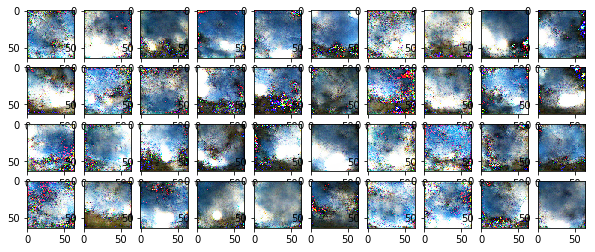

Step 1100: Generator Loss: 1.730243, Discriminator Loss: 0.175748
Step 1200: Generator Loss: 3.387795, Discriminator Loss: 0.112592
Step 1300: Generator Loss: 3.175910, Discriminator Loss: 0.041670
Step 1400: Generator Loss: 3.038719, Discriminator Loss: 0.067542
Step 1500: Generator Loss: 4.893142, Discriminator Loss: 0.027554
Step 1600: Generator Loss: 4.263642, Discriminator Loss: 0.024946
Step 1700: Generator Loss: 3.925978, Discriminator Loss: 0.015622
Step 1800: Generator Loss: 5.080188, Discriminator Loss: 0.007828
Step 1900: Generator Loss: 5.320674, Discriminator Loss: 0.027867
Step 2000: Generator Loss: 3.342362, Discriminator Loss: 0.161460


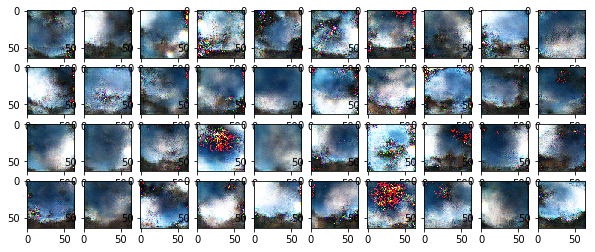

Step 2100: Generator Loss: 3.728885, Discriminator Loss: 0.027970
Step 2200: Generator Loss: 5.573743, Discriminator Loss: 0.016053
Step 2300: Generator Loss: 5.000314, Discriminator Loss: 0.009383
Step 2400: Generator Loss: 4.937951, Discriminator Loss: 0.008586
Step 2500: Generator Loss: 6.095948, Discriminator Loss: 0.006043
Step 2600: Generator Loss: 7.019573, Discriminator Loss: 0.004389
Step 2700: Generator Loss: 2.662937, Discriminator Loss: 0.126655
Step 2800: Generator Loss: 4.898671, Discriminator Loss: 0.025878
Step 2900: Generator Loss: 4.356450, Discriminator Loss: 0.023753
Step 3000: Generator Loss: 5.442227, Discriminator Loss: 0.006658


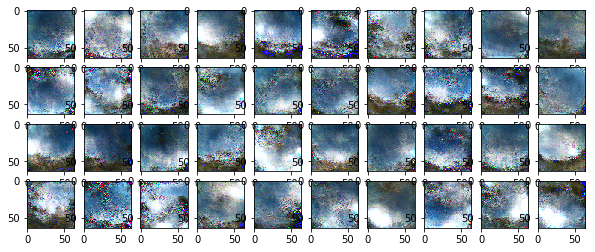

Step 3100: Generator Loss: 5.060150, Discriminator Loss: 0.006445
Step 3200: Generator Loss: 6.731370, Discriminator Loss: 0.009032
Step 3300: Generator Loss: 5.461484, Discriminator Loss: 0.017305
Step 3400: Generator Loss: 3.745522, Discriminator Loss: 0.040592
Step 3500: Generator Loss: 6.456364, Discriminator Loss: 0.003726
Step 3600: Generator Loss: 5.739628, Discriminator Loss: 0.006813
Step 3700: Generator Loss: 6.039042, Discriminator Loss: 0.002415
Step 3800: Generator Loss: 6.797008, Discriminator Loss: 0.002055
Step 3900: Generator Loss: 7.440875, Discriminator Loss: 0.002424
Step 4000: Generator Loss: 7.353996, Discriminator Loss: 0.001415


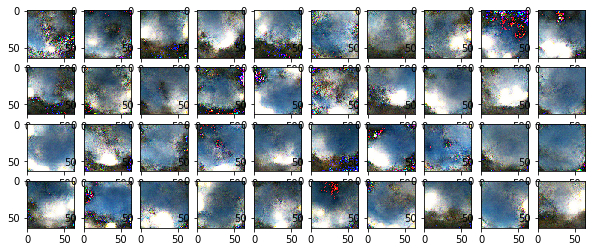

Step 4100: Generator Loss: 7.699352, Discriminator Loss: 0.001537
Step 4200: Generator Loss: 5.719220, Discriminator Loss: 0.003675
Step 4300: Generator Loss: 6.412244, Discriminator Loss: 0.002655
Step 4400: Generator Loss: 6.747600, Discriminator Loss: 0.002160
Step 4500: Generator Loss: 8.150537, Discriminator Loss: 0.002613
Step 4600: Generator Loss: 1.307352, Discriminator Loss: 0.564651
Step 4700: Generator Loss: 2.815470, Discriminator Loss: 0.096067
Step 4800: Generator Loss: 3.790889, Discriminator Loss: 0.061511
Step 4900: Generator Loss: 2.984212, Discriminator Loss: 0.056215
Step 5000: Generator Loss: 5.108368, Discriminator Loss: 0.010784


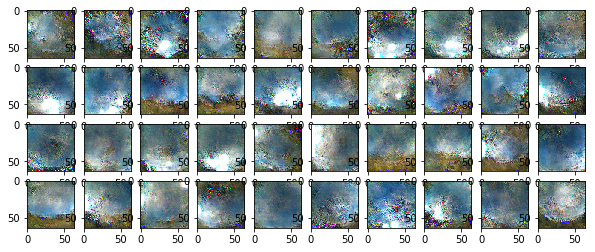

Step 5100: Generator Loss: 4.275384, Discriminator Loss: 0.017636
Step 5200: Generator Loss: 3.583577, Discriminator Loss: 0.028726
Step 5300: Generator Loss: 5.304681, Discriminator Loss: 0.005608
Step 5400: Generator Loss: 6.349660, Discriminator Loss: 0.005789
Step 5500: Generator Loss: 5.165178, Discriminator Loss: 0.007442
Step 5600: Generator Loss: 5.964510, Discriminator Loss: 0.005675
Step 5700: Generator Loss: 6.765013, Discriminator Loss: 0.004399
Step 5800: Generator Loss: 6.221877, Discriminator Loss: 0.002851
Step 5900: Generator Loss: 6.302982, Discriminator Loss: 0.007209
Step 6000: Generator Loss: 6.774500, Discriminator Loss: 0.001500


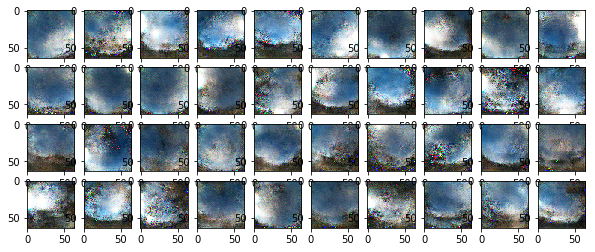

Step 6100: Generator Loss: 2.206643, Discriminator Loss: 0.583066
Step 6200: Generator Loss: 2.825572, Discriminator Loss: 0.097273
Step 6300: Generator Loss: 5.521649, Discriminator Loss: 0.012449
Step 6400: Generator Loss: 4.495588, Discriminator Loss: 0.017627
Step 6500: Generator Loss: 6.180167, Discriminator Loss: 0.006305
Step 6600: Generator Loss: 6.638181, Discriminator Loss: 0.005216
Step 6700: Generator Loss: 5.578713, Discriminator Loss: 0.005055
Step 6800: Generator Loss: 5.762642, Discriminator Loss: 0.005219
Step 6900: Generator Loss: 6.113483, Discriminator Loss: 0.003167
Step 7000: Generator Loss: 6.028670, Discriminator Loss: 0.008380


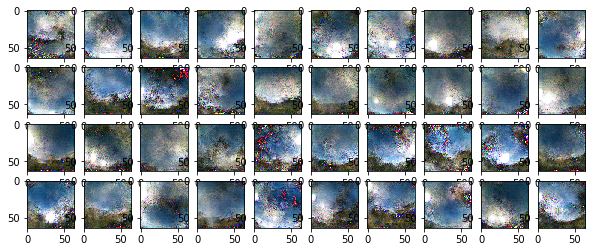

Step 7100: Generator Loss: 5.701175, Discriminator Loss: 0.006772
Step 7200: Generator Loss: 6.577292, Discriminator Loss: 0.002263
Step 7300: Generator Loss: 6.688129, Discriminator Loss: 0.002770
Step 7400: Generator Loss: 6.619284, Discriminator Loss: 0.001713
Step 7500: Generator Loss: 2.243765, Discriminator Loss: 0.165735
Step 7600: Generator Loss: 4.488927, Discriminator Loss: 0.011207
Step 7700: Generator Loss: 5.727875, Discriminator Loss: 0.010103
Step 7800: Generator Loss: 6.310366, Discriminator Loss: 0.008071
Step 7900: Generator Loss: 5.752312, Discriminator Loss: 0.007778
Step 8000: Generator Loss: 5.637810, Discriminator Loss: 0.003909


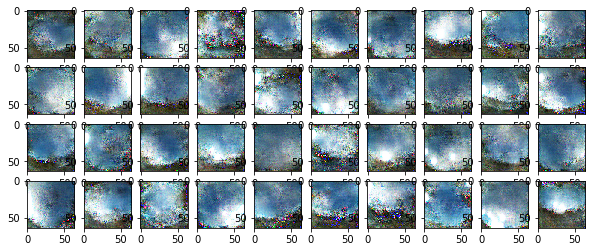

Step 8100: Generator Loss: 6.092177, Discriminator Loss: 0.003048
Step 8200: Generator Loss: 7.587963, Discriminator Loss: 0.001290
Step 8300: Generator Loss: 8.291728, Discriminator Loss: 0.001553
Step 8400: Generator Loss: 8.526744, Discriminator Loss: 0.001559
Step 8500: Generator Loss: 9.691130, Discriminator Loss: 0.000592
Step 8600: Generator Loss: 8.071281, Discriminator Loss: 0.001342
Step 8700: Generator Loss: 8.469492, Discriminator Loss: 0.001142
Step 8800: Generator Loss: 7.356206, Discriminator Loss: 0.001071
Step 8900: Generator Loss: 7.669503, Discriminator Loss: 0.000663
Step 9000: Generator Loss: 7.983159, Discriminator Loss: 0.000394


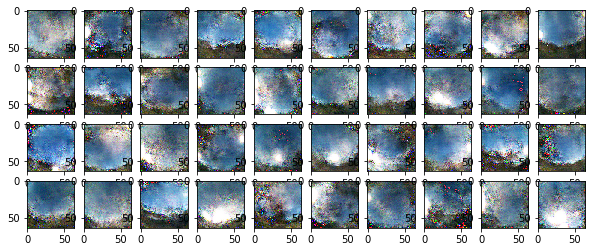

Step 9100: Generator Loss: 9.294458, Discriminator Loss: 0.000631
Step 9200: Generator Loss: 10.418467, Discriminator Loss: 0.001048
Step 9300: Generator Loss: 8.120103, Discriminator Loss: 0.000465
Step 9400: Generator Loss: 7.543986, Discriminator Loss: 0.001201
Step 9500: Generator Loss: 8.434634, Discriminator Loss: 0.000427
Step 9600: Generator Loss: 9.115830, Discriminator Loss: 0.000551
Step 9700: Generator Loss: 9.319752, Discriminator Loss: 0.000251
Step 9800: Generator Loss: 6.723866, Discriminator Loss: 0.002670
Step 9900: Generator Loss: 8.893106, Discriminator Loss: 0.000443
Step 10000: Generator Loss: 9.269753, Discriminator Loss: 0.000392


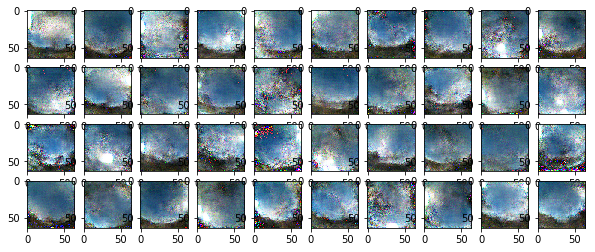

Step 10100: Generator Loss: 8.655117, Discriminator Loss: 0.000271
Step 10200: Generator Loss: 9.862960, Discriminator Loss: 0.000194
Step 10300: Generator Loss: 8.746466, Discriminator Loss: 0.000298
Step 10400: Generator Loss: 10.202449, Discriminator Loss: 0.000214
Step 10500: Generator Loss: 8.953705, Discriminator Loss: 0.000193
Step 10600: Generator Loss: 8.203316, Discriminator Loss: 0.000424
Step 10700: Generator Loss: 9.366342, Discriminator Loss: 0.000308
Step 10800: Generator Loss: 1.328782, Discriminator Loss: 0.511265
Step 10900: Generator Loss: 1.861882, Discriminator Loss: 1.335760
Step 11000: Generator Loss: 1.502382, Discriminator Loss: 1.234900


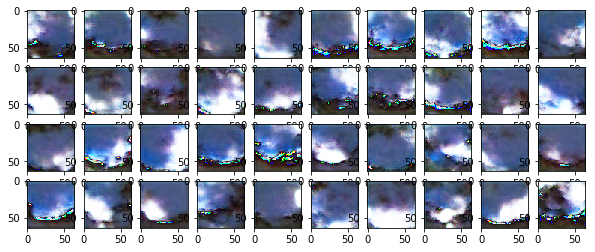

Step 11100: Generator Loss: 1.672680, Discriminator Loss: 0.158486
Step 11200: Generator Loss: 1.082739, Discriminator Loss: 0.322931
Step 11300: Generator Loss: 2.676832, Discriminator Loss: 0.493290
Step 11400: Generator Loss: 3.936744, Discriminator Loss: 0.230715
Step 11500: Generator Loss: 3.729722, Discriminator Loss: 0.063122
Step 11600: Generator Loss: 4.318040, Discriminator Loss: 0.026537
Step 11700: Generator Loss: 3.190761, Discriminator Loss: 0.080349
Step 11800: Generator Loss: 3.698872, Discriminator Loss: 0.054951
Step 11900: Generator Loss: 5.271283, Discriminator Loss: 0.009819
Step 12000: Generator Loss: 4.379768, Discriminator Loss: 0.017727


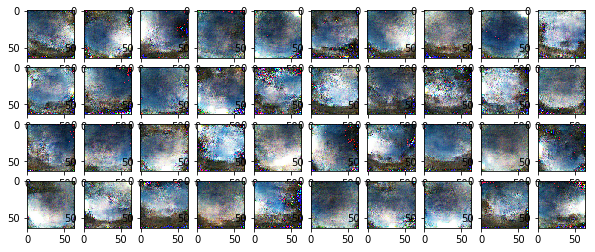

Step 12100: Generator Loss: 4.950720, Discriminator Loss: 0.009150
Step 12200: Generator Loss: 3.803320, Discriminator Loss: 0.118109
Step 12300: Generator Loss: 5.239849, Discriminator Loss: 0.015004
Step 12400: Generator Loss: 6.215754, Discriminator Loss: 0.007198
Step 12500: Generator Loss: 6.567605, Discriminator Loss: 0.006038
Step 12600: Generator Loss: 4.727235, Discriminator Loss: 0.019664
Step 12700: Generator Loss: 6.037942, Discriminator Loss: 0.002777
Step 12800: Generator Loss: 3.310032, Discriminator Loss: 0.087009
Step 12900: Generator Loss: 5.779562, Discriminator Loss: 0.016150
Step 13000: Generator Loss: 6.252028, Discriminator Loss: 0.003594


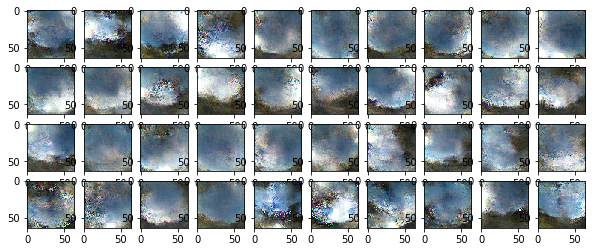

Step 13100: Generator Loss: 6.028100, Discriminator Loss: 0.008424
Step 13200: Generator Loss: 6.956984, Discriminator Loss: 0.001264
Step 13300: Generator Loss: 6.457198, Discriminator Loss: 0.002712
Step 13400: Generator Loss: 5.989132, Discriminator Loss: 0.076593
Step 13500: Generator Loss: 6.240510, Discriminator Loss: 0.004871
Step 13600: Generator Loss: 5.984784, Discriminator Loss: 0.008102
Step 13700: Generator Loss: 6.829635, Discriminator Loss: 0.003861
Step 13800: Generator Loss: 6.626219, Discriminator Loss: 0.002300
Step 13900: Generator Loss: 7.931726, Discriminator Loss: 0.001042
Step 14000: Generator Loss: 7.665913, Discriminator Loss: 0.003645


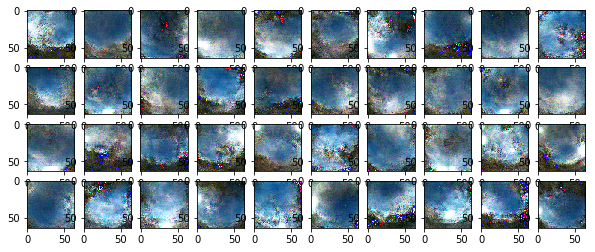

Step 14100: Generator Loss: 7.013026, Discriminator Loss: 0.002207
Step 14200: Generator Loss: 7.949617, Discriminator Loss: 0.000889
Step 14300: Generator Loss: 8.483721, Discriminator Loss: 0.000572
Step 14400: Generator Loss: 8.448681, Discriminator Loss: 0.000909
Step 14500: Generator Loss: 8.865927, Discriminator Loss: 0.000656
Step 14600: Generator Loss: 2.513049, Discriminator Loss: 0.712404
Step 14700: Generator Loss: 3.985729, Discriminator Loss: 0.335700
Step 14800: Generator Loss: 6.027318, Discriminator Loss: 0.037441
Step 14900: Generator Loss: 4.646471, Discriminator Loss: 0.018953
Step 15000: Generator Loss: 4.574914, Discriminator Loss: 0.051179


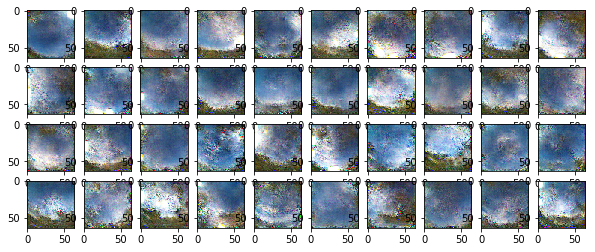

Step 15100: Generator Loss: 5.304982, Discriminator Loss: 0.010560
Step 15200: Generator Loss: 5.997900, Discriminator Loss: 0.003562
Step 15300: Generator Loss: 5.586297, Discriminator Loss: 0.004594
Step 15400: Generator Loss: 4.876305, Discriminator Loss: 0.010909
Step 15500: Generator Loss: 6.380354, Discriminator Loss: 0.009408
Step 15600: Generator Loss: 7.170049, Discriminator Loss: 0.002742
Step 15700: Generator Loss: 8.073973, Discriminator Loss: 0.004236
Step 15800: Generator Loss: 7.371137, Discriminator Loss: 0.001658
Step 15900: Generator Loss: 8.063418, Discriminator Loss: 0.001020
Step 16000: Generator Loss: 7.800940, Discriminator Loss: 0.002611


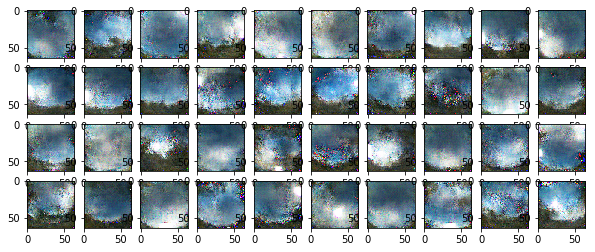

Step 16100: Generator Loss: 8.330532, Discriminator Loss: 0.000673
Step 16200: Generator Loss: 6.569716, Discriminator Loss: 0.013569
Step 16300: Generator Loss: 8.031026, Discriminator Loss: 0.008619
Step 16400: Generator Loss: 5.143753, Discriminator Loss: 0.005523
Step 16500: Generator Loss: 7.770725, Discriminator Loss: 0.001746
Step 16600: Generator Loss: 7.352311, Discriminator Loss: 0.001900
Step 16700: Generator Loss: 7.388126, Discriminator Loss: 0.001750
Step 16800: Generator Loss: 7.485862, Discriminator Loss: 0.001917
Step 16900: Generator Loss: 7.067079, Discriminator Loss: 0.001471
Step 17000: Generator Loss: 8.442698, Discriminator Loss: 0.000812


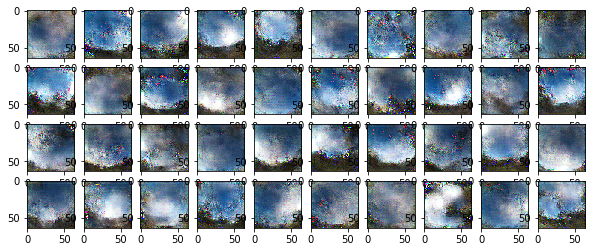

Step 17100: Generator Loss: 8.351339, Discriminator Loss: 0.000569
Step 17200: Generator Loss: 6.833623, Discriminator Loss: 0.001553
Step 17300: Generator Loss: 8.605669, Discriminator Loss: 0.000719
Step 17400: Generator Loss: 8.752135, Discriminator Loss: 0.000460
Step 17500: Generator Loss: 8.913775, Discriminator Loss: 0.000353
Step 17600: Generator Loss: 9.779523, Discriminator Loss: 0.000394
Step 17700: Generator Loss: 9.011860, Discriminator Loss: 0.000311
Step 17800: Generator Loss: 8.543446, Discriminator Loss: 0.000633
Step 17900: Generator Loss: 9.064949, Discriminator Loss: 0.000332
Step 18000: Generator Loss: 9.554851, Discriminator Loss: 0.000408


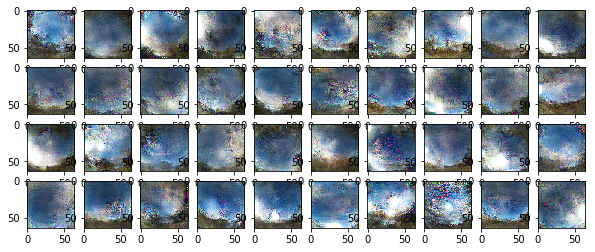

Step 18100: Generator Loss: 8.839149, Discriminator Loss: 0.000384
Step 18200: Generator Loss: 9.331758, Discriminator Loss: 0.000196
Step 18300: Generator Loss: 3.569576, Discriminator Loss: 0.100280
Step 18400: Generator Loss: 6.622107, Discriminator Loss: 0.085872
Step 18500: Generator Loss: 6.034314, Discriminator Loss: 0.007733
Step 18600: Generator Loss: 6.710617, Discriminator Loss: 0.004025
Step 18700: Generator Loss: 7.564446, Discriminator Loss: 0.004638
Step 18800: Generator Loss: 6.890119, Discriminator Loss: 0.002142
Step 18900: Generator Loss: 7.563698, Discriminator Loss: 0.003353
Step 19000: Generator Loss: 9.002251, Discriminator Loss: 0.002685


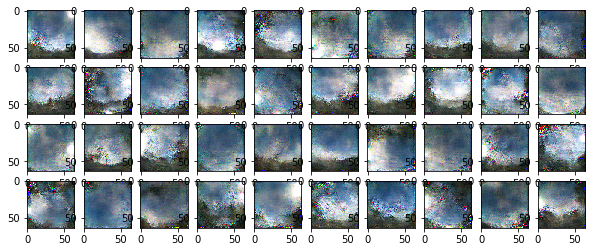

Step 19100: Generator Loss: 7.784618, Discriminator Loss: 0.003587
Step 19200: Generator Loss: 7.253080, Discriminator Loss: 0.001195
Step 19300: Generator Loss: 5.941481, Discriminator Loss: 0.003494
Step 19400: Generator Loss: 6.745286, Discriminator Loss: 0.005255
Step 19500: Generator Loss: 8.591826, Discriminator Loss: 0.000849
Step 19600: Generator Loss: 9.605608, Discriminator Loss: 0.000398
Step 19700: Generator Loss: 8.983823, Discriminator Loss: 0.001784
Step 19800: Generator Loss: 9.251368, Discriminator Loss: 0.000685
Step 19900: Generator Loss: 10.339493, Discriminator Loss: 0.000600
Step 20000: Generator Loss: 8.342381, Discriminator Loss: 0.000771


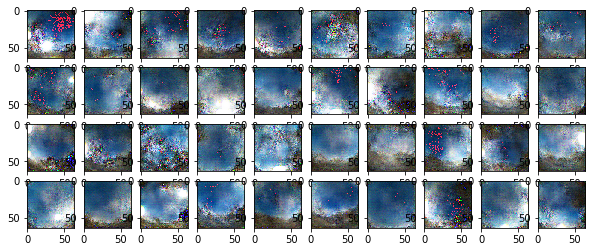

Step 20100: Generator Loss: 9.912271, Discriminator Loss: 0.000515
Step 20200: Generator Loss: 9.913024, Discriminator Loss: 0.000282
Step 20300: Generator Loss: 8.751228, Discriminator Loss: 0.001224
Step 20400: Generator Loss: 10.159212, Discriminator Loss: 0.000353
Step 20500: Generator Loss: 8.296238, Discriminator Loss: 0.000473
Step 20600: Generator Loss: 10.073874, Discriminator Loss: 0.000523
Step 20700: Generator Loss: 9.447281, Discriminator Loss: 0.000231
Step 20800: Generator Loss: 10.649426, Discriminator Loss: 0.000212
Step 20900: Generator Loss: 9.816193, Discriminator Loss: 0.000206
Step 21000: Generator Loss: 7.966333, Discriminator Loss: 0.000491


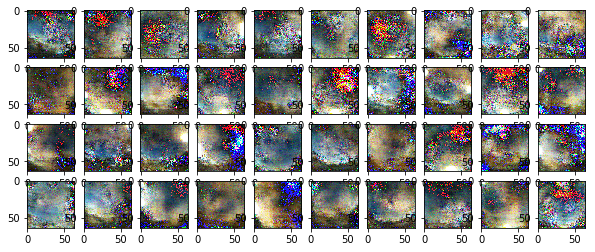

Step 21100: Generator Loss: 10.634375, Discriminator Loss: 0.000147
Step 21200: Generator Loss: 9.356107, Discriminator Loss: 0.000298
Step 21300: Generator Loss: 8.062550, Discriminator Loss: 0.000384
Step 21400: Generator Loss: 9.774302, Discriminator Loss: 0.000183
Step 21500: Generator Loss: 9.486594, Discriminator Loss: 0.000204
Step 21600: Generator Loss: 10.729916, Discriminator Loss: 0.000157
Step 21700: Generator Loss: 8.716314, Discriminator Loss: 0.000304
Step 21800: Generator Loss: 10.233791, Discriminator Loss: 0.000091
Step 21900: Generator Loss: 10.215345, Discriminator Loss: 0.000167
Step 22000: Generator Loss: 8.306276, Discriminator Loss: 0.000433


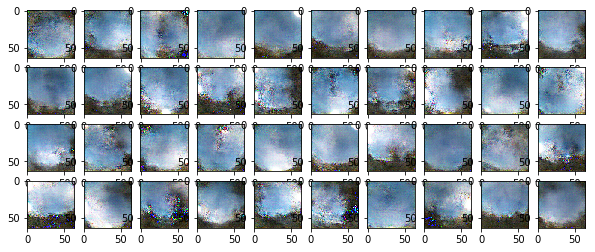

Step 22100: Generator Loss: 10.581448, Discriminator Loss: 0.000109
Step 22200: Generator Loss: 10.200140, Discriminator Loss: 0.000140
Step 22300: Generator Loss: 9.087266, Discriminator Loss: 0.000215
Step 22400: Generator Loss: 3.100444, Discriminator Loss: 0.310494
Step 22500: Generator Loss: 4.432410, Discriminator Loss: 0.039969
Step 22600: Generator Loss: 5.197066, Discriminator Loss: 0.016132
Step 22700: Generator Loss: 5.700737, Discriminator Loss: 0.009491
Step 22800: Generator Loss: 7.257737, Discriminator Loss: 0.003282
Step 22900: Generator Loss: 8.328968, Discriminator Loss: 0.003169
Step 23000: Generator Loss: 7.359499, Discriminator Loss: 0.003317


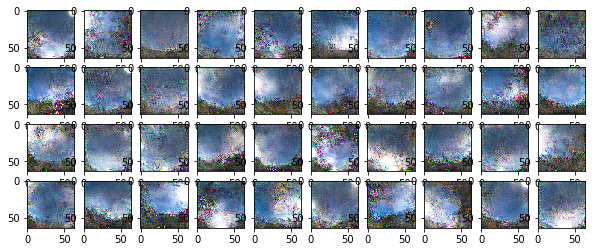

Step 23100: Generator Loss: 7.995896, Discriminator Loss: 0.001564
Step 23200: Generator Loss: 8.567248, Discriminator Loss: 0.001517
Step 23300: Generator Loss: 7.996969, Discriminator Loss: 0.001243
Step 23400: Generator Loss: 8.617006, Discriminator Loss: 0.000747
Step 23500: Generator Loss: 6.858327, Discriminator Loss: 0.003287
Step 23600: Generator Loss: 8.812658, Discriminator Loss: 0.000528
Step 23700: Generator Loss: 8.446363, Discriminator Loss: 0.002074
Step 23800: Generator Loss: 9.218386, Discriminator Loss: 0.000268
Step 23900: Generator Loss: 7.786617, Discriminator Loss: 0.000812
Step 24000: Generator Loss: 8.014616, Discriminator Loss: 0.000984


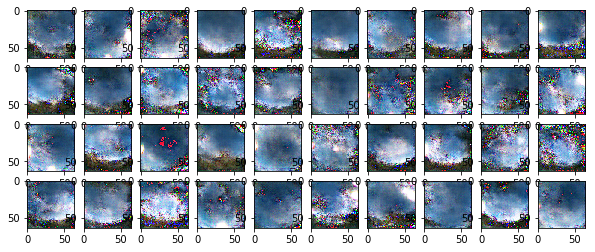

Step 24100: Generator Loss: 8.104324, Discriminator Loss: 0.000987
Step 24200: Generator Loss: 8.761059, Discriminator Loss: 0.000439
Step 24300: Generator Loss: 7.970541, Discriminator Loss: 0.002477
Step 24400: Generator Loss: 9.984820, Discriminator Loss: 0.000799
Step 24500: Generator Loss: 8.076912, Discriminator Loss: 0.000730
Step 24600: Generator Loss: 9.016682, Discriminator Loss: 0.000931
Step 24700: Generator Loss: 8.905014, Discriminator Loss: 0.000758
Step 24800: Generator Loss: 10.757578, Discriminator Loss: 0.000597
Step 24900: Generator Loss: 7.875585, Discriminator Loss: 0.001909
Step 25000: Generator Loss: 9.344991, Discriminator Loss: 0.000420


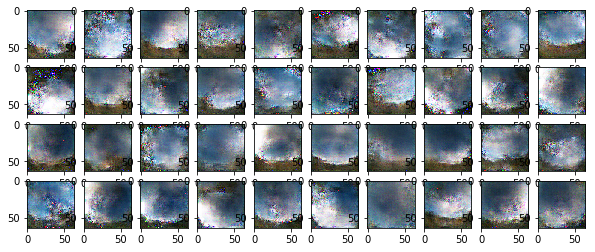

Step 25100: Generator Loss: 6.357091, Discriminator Loss: 0.005508
Step 25200: Generator Loss: 7.928547, Discriminator Loss: 0.002668
Step 25300: Generator Loss: 9.008150, Discriminator Loss: 0.000633
Step 25400: Generator Loss: 9.306414, Discriminator Loss: 0.000770
Step 25500: Generator Loss: 9.382624, Discriminator Loss: 0.000432
Step 25600: Generator Loss: 5.622643, Discriminator Loss: 0.005816
Step 25700: Generator Loss: 4.567336, Discriminator Loss: 0.006663
Step 25800: Generator Loss: 7.146516, Discriminator Loss: 0.003337
Step 25900: Generator Loss: 6.094523, Discriminator Loss: 0.008015
Step 26000: Generator Loss: 6.410107, Discriminator Loss: 0.002156


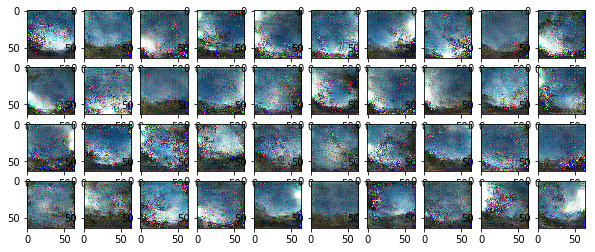

Step 26100: Generator Loss: 9.212800, Discriminator Loss: 0.001650
Step 26200: Generator Loss: 8.147065, Discriminator Loss: 0.001690
Step 26300: Generator Loss: 7.218587, Discriminator Loss: 0.003056
Step 26400: Generator Loss: 9.422955, Discriminator Loss: 0.000546
Step 26500: Generator Loss: 7.705558, Discriminator Loss: 0.000680
Step 26600: Generator Loss: 8.249433, Discriminator Loss: 0.000573
Step 26700: Generator Loss: 7.179155, Discriminator Loss: 0.001052
Step 26800: Generator Loss: 6.662812, Discriminator Loss: 0.003172
Step 26900: Generator Loss: 10.714220, Discriminator Loss: 0.001211
Step 27000: Generator Loss: 8.562252, Discriminator Loss: 0.000415


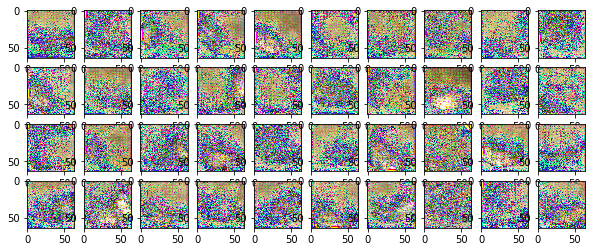

Step 27100: Generator Loss: 8.423332, Discriminator Loss: 0.000631
Step 27200: Generator Loss: 9.635889, Discriminator Loss: 0.001003
Step 27300: Generator Loss: 8.835285, Discriminator Loss: 0.000552
Step 27400: Generator Loss: 10.140856, Discriminator Loss: 0.000391
Step 27500: Generator Loss: 9.231520, Discriminator Loss: 0.000738
Step 27600: Generator Loss: 9.742582, Discriminator Loss: 0.000271
Step 27700: Generator Loss: 10.656965, Discriminator Loss: 0.000477
Step 27800: Generator Loss: 2.289710, Discriminator Loss: 0.379527
Step 27900: Generator Loss: 5.675625, Discriminator Loss: 0.006719
Step 28000: Generator Loss: 6.185419, Discriminator Loss: 0.004150


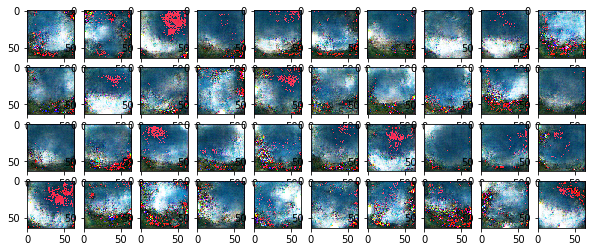

Step 28100: Generator Loss: 8.599051, Discriminator Loss: 0.001319
Step 28200: Generator Loss: 9.831829, Discriminator Loss: 0.000871
Step 28300: Generator Loss: 6.781571, Discriminator Loss: 0.003081
Step 28400: Generator Loss: 8.559096, Discriminator Loss: 0.001288
Step 28500: Generator Loss: 7.935470, Discriminator Loss: 0.003082
Step 28600: Generator Loss: 7.106959, Discriminator Loss: 0.001391
Step 28700: Generator Loss: 7.510414, Discriminator Loss: 0.001312
Step 28800: Generator Loss: 6.557023, Discriminator Loss: 0.001609
Step 28900: Generator Loss: 9.977268, Discriminator Loss: 0.000374
Step 29000: Generator Loss: 7.831143, Discriminator Loss: 0.001329


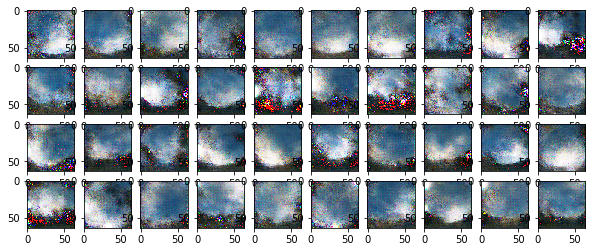

Step 29100: Generator Loss: 9.130652, Discriminator Loss: 0.001232
Step 29200: Generator Loss: 8.697474, Discriminator Loss: 0.001240
Step 29300: Generator Loss: 8.005059, Discriminator Loss: 0.000422
Step 29400: Generator Loss: 7.288640, Discriminator Loss: 0.000982
Step 29500: Generator Loss: 9.541438, Discriminator Loss: 0.001599
Step 29600: Generator Loss: 9.999091, Discriminator Loss: 0.000256
Step 29700: Generator Loss: 10.629938, Discriminator Loss: 0.000446
Step 29800: Generator Loss: 10.066141, Discriminator Loss: 0.000188
Step 29900: Generator Loss: 10.630595, Discriminator Loss: 0.000082
Step 30000: Generator Loss: 9.323501, Discriminator Loss: 0.000243


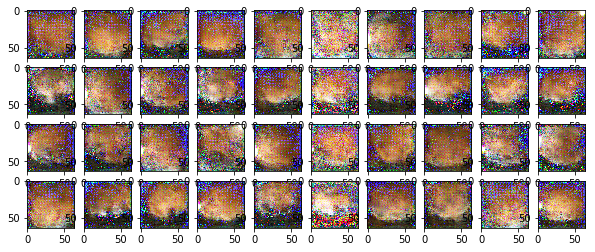

Step 30100: Generator Loss: 10.512630, Discriminator Loss: 0.000177
Step 30200: Generator Loss: 10.590380, Discriminator Loss: 0.000107
Step 30300: Generator Loss: 10.541677, Discriminator Loss: 0.000067
Step 30400: Generator Loss: 10.360185, Discriminator Loss: 0.000055
Step 30500: Generator Loss: 9.642302, Discriminator Loss: 0.000118
Step 30600: Generator Loss: 16.433048, Discriminator Loss: 0.000013
Step 30700: Generator Loss: 10.457257, Discriminator Loss: 0.023070
Step 30800: Generator Loss: 10.584351, Discriminator Loss: 0.000391
Step 30900: Generator Loss: 6.917517, Discriminator Loss: 0.004228
Step 31000: Generator Loss: 7.331160, Discriminator Loss: 0.001802


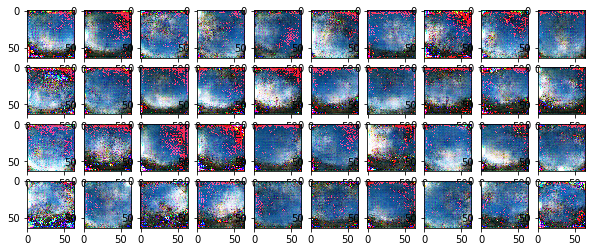

Step 31100: Generator Loss: 6.881111, Discriminator Loss: 0.001997
Step 31200: Generator Loss: 7.447545, Discriminator Loss: 0.001842
Step 31300: Generator Loss: 8.365241, Discriminator Loss: 0.001078
Step 31400: Generator Loss: 7.625245, Discriminator Loss: 0.005279
Step 31500: Generator Loss: 9.613918, Discriminator Loss: 0.000815
Step 31600: Generator Loss: 9.214970, Discriminator Loss: 0.002228
Step 31700: Generator Loss: 8.916402, Discriminator Loss: 0.000731
Step 31800: Generator Loss: 10.559965, Discriminator Loss: 0.000266
Step 31900: Generator Loss: 10.275944, Discriminator Loss: 0.000285
Step 32000: Generator Loss: 9.419712, Discriminator Loss: 0.000525


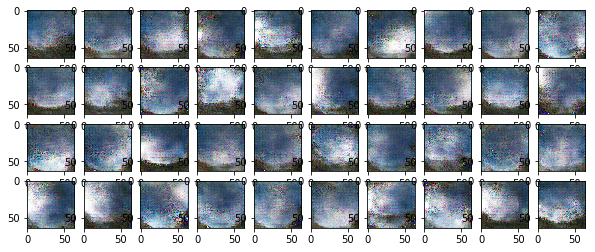

Step 32100: Generator Loss: 11.989504, Discriminator Loss: 0.000260
Step 32200: Generator Loss: 8.358730, Discriminator Loss: 0.268433
Step 32300: Generator Loss: 9.679600, Discriminator Loss: 0.004765
Step 32400: Generator Loss: 9.542830, Discriminator Loss: 0.000163
Step 32500: Generator Loss: 10.184381, Discriminator Loss: 0.000083
Step 32600: Generator Loss: 9.179187, Discriminator Loss: 0.002209
Step 32700: Generator Loss: 8.319879, Discriminator Loss: 0.000387
Step 32800: Generator Loss: 8.462576, Discriminator Loss: 0.000394
Step 32900: Generator Loss: 9.867079, Discriminator Loss: 0.000166
Step 33000: Generator Loss: 10.486826, Discriminator Loss: 0.000668


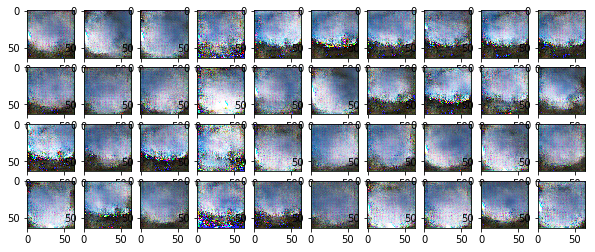

Step 33100: Generator Loss: 7.939713, Discriminator Loss: 0.000539
Step 33200: Generator Loss: 8.838518, Discriminator Loss: 0.647494
Step 33300: Generator Loss: 7.849984, Discriminator Loss: 0.162170
Step 33400: Generator Loss: 8.067327, Discriminator Loss: 0.001510
Step 33500: Generator Loss: 5.827332, Discriminator Loss: 0.023863
Step 33600: Generator Loss: 9.711741, Discriminator Loss: 0.001047
Step 33700: Generator Loss: 16.585815, Discriminator Loss: 0.003875
Step 33800: Generator Loss: 6.991868, Discriminator Loss: 0.001177
Step 33900: Generator Loss: 7.447827, Discriminator Loss: 0.000935
Step 34000: Generator Loss: 8.549333, Discriminator Loss: 0.000421


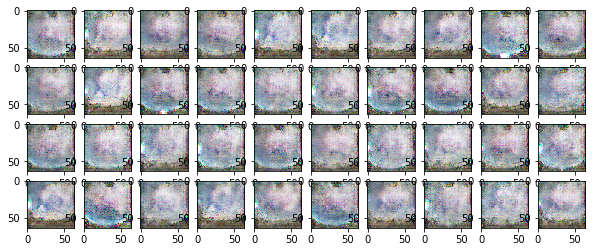

Step 34100: Generator Loss: 4.453458, Discriminator Loss: 0.015507
Step 34200: Generator Loss: 18.967834, Discriminator Loss: 0.006850
Step 34300: Generator Loss: 5.459081, Discriminator Loss: 0.008829
Step 34400: Generator Loss: 7.579384, Discriminator Loss: 0.000959
Step 34500: Generator Loss: 8.393671, Discriminator Loss: 0.000184
Step 34600: Generator Loss: 6.536499, Discriminator Loss: 0.001002
Step 34700: Generator Loss: 8.184101, Discriminator Loss: 0.006279
Step 34800: Generator Loss: 9.129573, Discriminator Loss: 0.000325
Step 34900: Generator Loss: 5.657393, Discriminator Loss: 0.002376
Step 35000: Generator Loss: 9.931425, Discriminator Loss: 0.000149


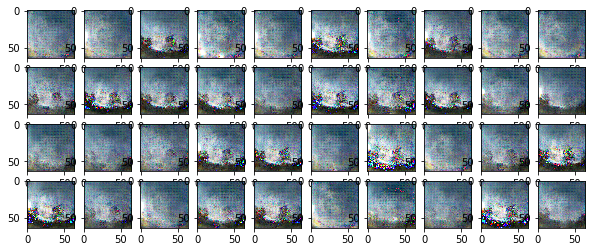

Step 35100: Generator Loss: 9.115063, Discriminator Loss: 0.000203
Step 35200: Generator Loss: 8.621340, Discriminator Loss: 0.000725
Step 35300: Generator Loss: 9.580976, Discriminator Loss: 0.007222
Step 35400: Generator Loss: 9.329515, Discriminator Loss: 0.000102
Step 35500: Generator Loss: 7.898704, Discriminator Loss: 0.000263
Step 35600: Generator Loss: 4.869805, Discriminator Loss: 0.004369
Step 35700: Generator Loss: 6.777881, Discriminator Loss: 0.000744
Step 35800: Generator Loss: 17.071281, Discriminator Loss: 0.001034
Step 35900: Generator Loss: 6.169475, Discriminator Loss: 0.002667
Step 36000: Generator Loss: 6.983631, Discriminator Loss: 0.003008


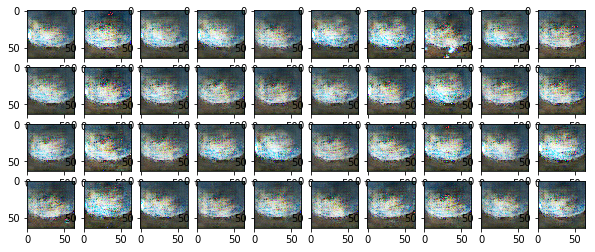

Step 36100: Generator Loss: 10.603399, Discriminator Loss: 0.000082
Step 36200: Generator Loss: 6.350353, Discriminator Loss: 0.002465
Step 36300: Generator Loss: 5.501161, Discriminator Loss: 0.002681
Step 36400: Generator Loss: 6.464746, Discriminator Loss: 0.001028
Step 36500: Generator Loss: 6.841476, Discriminator Loss: 0.000624
Step 36600: Generator Loss: 6.304145, Discriminator Loss: 0.001003
Step 36700: Generator Loss: 10.496245, Discriminator Loss: 0.000723
Step 36800: Generator Loss: 7.406622, Discriminator Loss: 0.000724
Step 36900: Generator Loss: 7.633846, Discriminator Loss: 0.006761
Step 37000: Generator Loss: 5.523572, Discriminator Loss: 0.002488


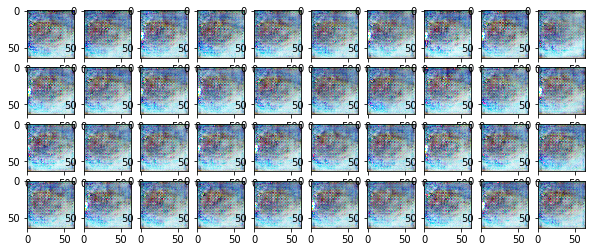

Step 37100: Generator Loss: 12.604406, Discriminator Loss: 0.007893
Step 37200: Generator Loss: 5.195167, Discriminator Loss: 0.012568
Step 37300: Generator Loss: 6.252170, Discriminator Loss: 0.001931
Step 37400: Generator Loss: 7.167302, Discriminator Loss: 0.003764
Step 37500: Generator Loss: 5.690658, Discriminator Loss: 0.003841
Step 37600: Generator Loss: 6.334342, Discriminator Loss: 0.001792
Step 37700: Generator Loss: 8.271441, Discriminator Loss: 0.000405
Step 37800: Generator Loss: 6.676541, Discriminator Loss: 0.000694
Step 37900: Generator Loss: 6.360739, Discriminator Loss: 0.001087
Step 38000: Generator Loss: 7.030074, Discriminator Loss: 0.000603


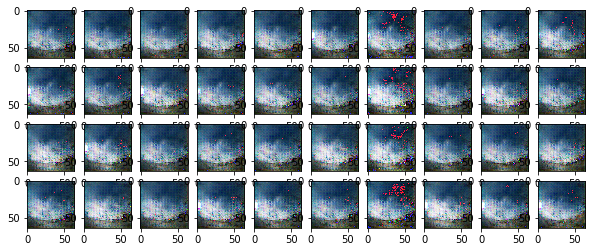

Step 38100: Generator Loss: 8.854029, Discriminator Loss: 0.000155
Step 38200: Generator Loss: 7.548565, Discriminator Loss: 0.001542
Step 38300: Generator Loss: 7.508144, Discriminator Loss: 0.000714
Step 38400: Generator Loss: 7.655153, Discriminator Loss: 0.000845
Step 38500: Generator Loss: 7.551857, Discriminator Loss: 0.000595
Step 38600: Generator Loss: 7.921049, Discriminator Loss: 0.000298
Step 38700: Generator Loss: 7.416677, Discriminator Loss: 0.000499
Step 38800: Generator Loss: 5.999475, Discriminator Loss: 0.001406
Step 38900: Generator Loss: 7.838584, Discriminator Loss: 0.000248
Step 39000: Generator Loss: 7.623837, Discriminator Loss: 0.000761


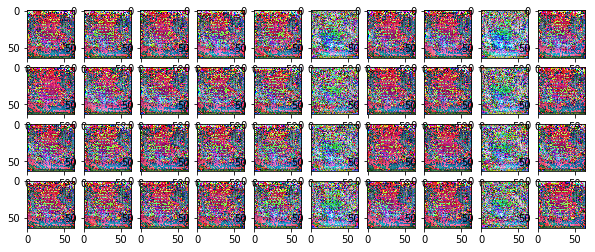

Step 39100: Generator Loss: 7.295442, Discriminator Loss: 0.001013
Step 39200: Generator Loss: 8.188414, Discriminator Loss: 0.000575
Step 39300: Generator Loss: 4.415979, Discriminator Loss: 0.010292
Step 39400: Generator Loss: 6.277055, Discriminator Loss: 0.001922
Step 39500: Generator Loss: 12.103176, Discriminator Loss: 0.000017
Step 39600: Generator Loss: 6.592960, Discriminator Loss: 0.002942
Step 39700: Generator Loss: 6.528266, Discriminator Loss: 0.001046
Step 39800: Generator Loss: 6.777157, Discriminator Loss: 0.002269
Step 39900: Generator Loss: 6.494611, Discriminator Loss: 0.001089
Step 40000: Generator Loss: 6.031195, Discriminator Loss: 0.001317


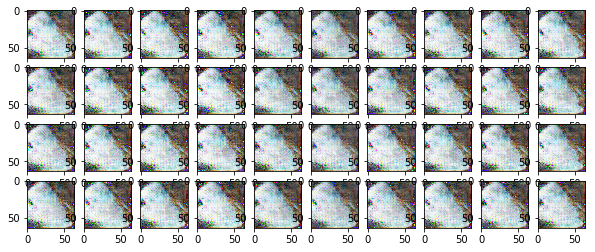

Step 40100: Generator Loss: 6.990113, Discriminator Loss: 0.000524
Step 40200: Generator Loss: 6.930515, Discriminator Loss: 0.001963
Step 40300: Generator Loss: 7.324656, Discriminator Loss: 0.000448
Step 40400: Generator Loss: 8.113140, Discriminator Loss: 0.000243
Step 40500: Generator Loss: 6.252100, Discriminator Loss: 0.001332
Step 40600: Generator Loss: 6.353265, Discriminator Loss: 0.001531
Step 40700: Generator Loss: 5.225739, Discriminator Loss: 0.003717
Step 40800: Generator Loss: 3.743031, Discriminator Loss: 0.012180
Step 40900: Generator Loss: 4.293344, Discriminator Loss: 0.010343
Step 41000: Generator Loss: 6.495378, Discriminator Loss: 0.001239


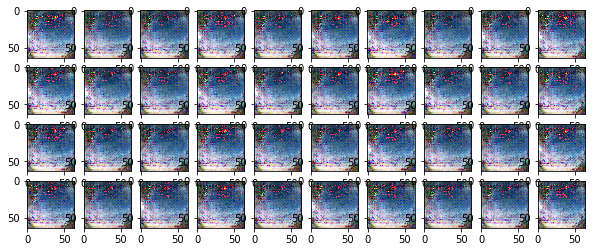

Step 41100: Generator Loss: 6.468920, Discriminator Loss: 0.002657
Step 41200: Generator Loss: 6.140396, Discriminator Loss: 0.001281
Step 41300: Generator Loss: 4.510046, Discriminator Loss: 0.005758
Step 41400: Generator Loss: 5.921522, Discriminator Loss: 0.002157
Step 41500: Generator Loss: 4.661942, Discriminator Loss: 0.005493
Step 41600: Generator Loss: 7.315916, Discriminator Loss: 0.000596
Step 41700: Generator Loss: 5.737493, Discriminator Loss: 0.003115
Step 41800: Generator Loss: 6.454785, Discriminator Loss: 0.000935
Step 41900: Generator Loss: 6.480419, Discriminator Loss: 0.001167
Step 42000: Generator Loss: 6.612719, Discriminator Loss: 0.000890


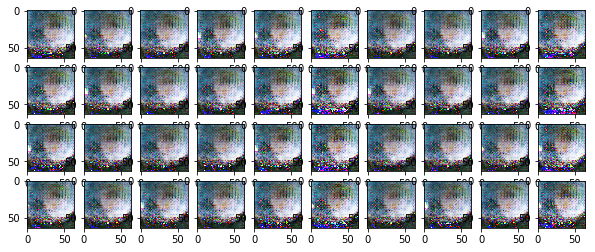

Step 42100: Generator Loss: 5.905733, Discriminator Loss: 0.011658
Step 42200: Generator Loss: 13.238270, Discriminator Loss: 0.000082
Step 42300: Generator Loss: 5.848649, Discriminator Loss: 0.002565
Step 42400: Generator Loss: 6.483683, Discriminator Loss: 0.000970
Step 42500: Generator Loss: 6.328333, Discriminator Loss: 0.001021
Step 42600: Generator Loss: 5.518521, Discriminator Loss: 0.003781
Step 42700: Generator Loss: 7.725028, Discriminator Loss: 0.000290
Step 42800: Generator Loss: 11.209648, Discriminator Loss: 0.000032
Step 42900: Generator Loss: 5.538703, Discriminator Loss: 0.002807
Step 43000: Generator Loss: 6.222824, Discriminator Loss: 0.002435


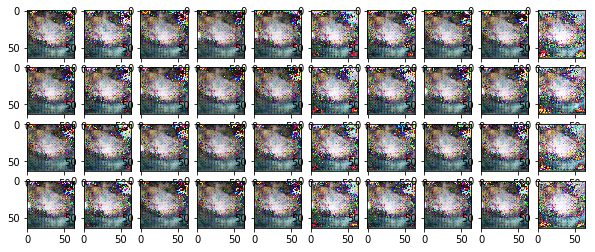

Step 43100: Generator Loss: 5.253771, Discriminator Loss: 0.002731
Step 43200: Generator Loss: 6.731193, Discriminator Loss: 0.001122
Step 43300: Generator Loss: 5.314167, Discriminator Loss: 0.002801
Step 43400: Generator Loss: 6.022687, Discriminator Loss: 0.001906
Step 43500: Generator Loss: 6.311039, Discriminator Loss: 0.076643
Step 43600: Generator Loss: 4.899384, Discriminator Loss: 0.004356
Step 43700: Generator Loss: 7.089159, Discriminator Loss: 0.001040
Step 43800: Generator Loss: 6.173996, Discriminator Loss: 0.001170
Step 43900: Generator Loss: 6.596560, Discriminator Loss: 0.002494
Step 44000: Generator Loss: 6.522440, Discriminator Loss: 0.000875


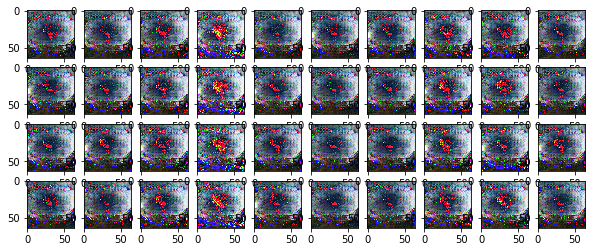

Step 44100: Generator Loss: 6.750450, Discriminator Loss: 0.012633
Step 44200: Generator Loss: 6.019910, Discriminator Loss: 0.001627
Step 44300: Generator Loss: 23.445198, Discriminator Loss: 0.001027
Step 44400: Generator Loss: 5.171848, Discriminator Loss: 0.003511
Step 44500: Generator Loss: 5.425954, Discriminator Loss: 0.003078
Step 44600: Generator Loss: 1.365219, Discriminator Loss: 0.224226
Step 44700: Generator Loss: 6.230860, Discriminator Loss: 0.001980
Step 44800: Generator Loss: 5.055403, Discriminator Loss: 0.003739
Step 44900: Generator Loss: 5.985239, Discriminator Loss: 0.001346
Step 45000: Generator Loss: 5.381935, Discriminator Loss: 0.002416


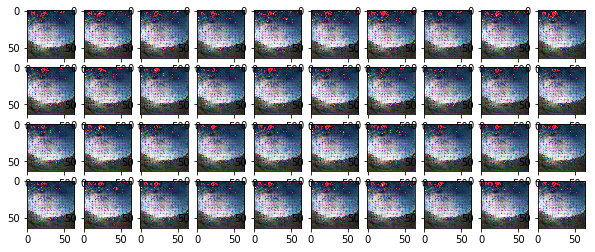

Step 45100: Generator Loss: 8.002134, Discriminator Loss: 0.000747
Step 45200: Generator Loss: 6.807451, Discriminator Loss: 0.000649
Step 45300: Generator Loss: 24.718506, Discriminator Loss: 0.002103
Step 45400: Generator Loss: 5.135150, Discriminator Loss: 0.004797
Step 45500: Generator Loss: 6.246548, Discriminator Loss: 0.001618
Step 45600: Generator Loss: 8.674505, Discriminator Loss: 0.000510
Step 45700: Generator Loss: 6.905814, Discriminator Loss: 0.012814
Step 45800: Generator Loss: 10.623421, Discriminator Loss: 0.000050
Step 45900: Generator Loss: 6.132928, Discriminator Loss: 0.001730
Step 46000: Generator Loss: 10.743743, Discriminator Loss: 0.000049


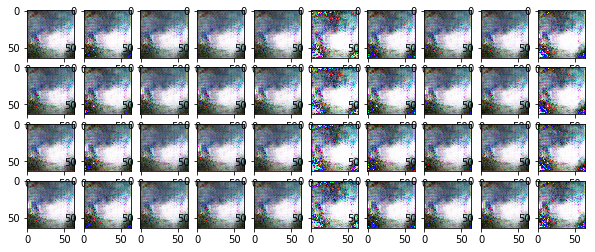

Step 46100: Generator Loss: 7.792567, Discriminator Loss: 0.000315
Step 46200: Generator Loss: 6.059361, Discriminator Loss: 0.001215
Step 46300: Generator Loss: 5.789620, Discriminator Loss: 0.001972
Step 46400: Generator Loss: 5.064434, Discriminator Loss: 0.010202
Step 46500: Generator Loss: 8.388194, Discriminator Loss: 0.000386
Step 46600: Generator Loss: 5.959716, Discriminator Loss: 0.113951
Step 46700: Generator Loss: 6.121988, Discriminator Loss: 0.001567
Step 46800: Generator Loss: 7.082956, Discriminator Loss: 0.000576
Step 46900: Generator Loss: 6.055369, Discriminator Loss: 0.001276
Step 47000: Generator Loss: 12.679531, Discriminator Loss: 0.000008


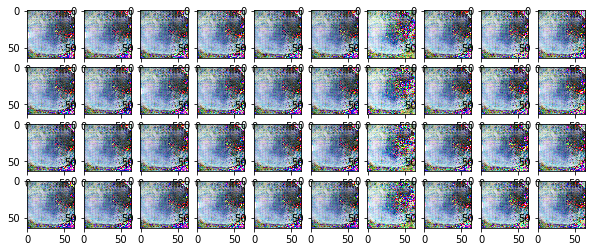

Step 47100: Generator Loss: 7.394239, Discriminator Loss: 0.000416
Step 47200: Generator Loss: 6.263358, Discriminator Loss: 0.001157
Step 47300: Generator Loss: 7.604941, Discriminator Loss: 0.000317
Step 47400: Generator Loss: 6.661308, Discriminator Loss: 0.001267
Step 47500: Generator Loss: 6.773643, Discriminator Loss: 0.000826
Step 47600: Generator Loss: 6.382868, Discriminator Loss: 0.001883
Step 47700: Generator Loss: 3.372170, Discriminator Loss: 0.018177
Step 47800: Generator Loss: 6.471852, Discriminator Loss: 0.003514
Step 47900: Generator Loss: 4.975616, Discriminator Loss: 0.003701
Step 48000: Generator Loss: 6.894618, Discriminator Loss: 0.000556


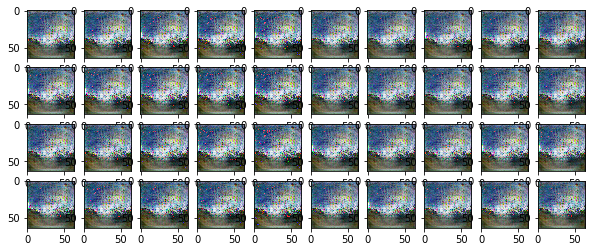

Step 48100: Generator Loss: 9.519376, Discriminator Loss: 0.000044
Step 48200: Generator Loss: 5.894624, Discriminator Loss: 0.019825
Step 48300: Generator Loss: 6.612888, Discriminator Loss: 0.001450
Step 48400: Generator Loss: 11.071068, Discriminator Loss: 0.000281
Step 48500: Generator Loss: 3.632175, Discriminator Loss: 0.014183
Step 48600: Generator Loss: 5.956253, Discriminator Loss: 0.001445
Step 48700: Generator Loss: 7.840261, Discriminator Loss: 0.000673
Step 48800: Generator Loss: 16.342766, Discriminator Loss: 0.000014
Step 48900: Generator Loss: 7.503311, Discriminator Loss: 0.000398
Step 49000: Generator Loss: 5.997291, Discriminator Loss: 0.002389


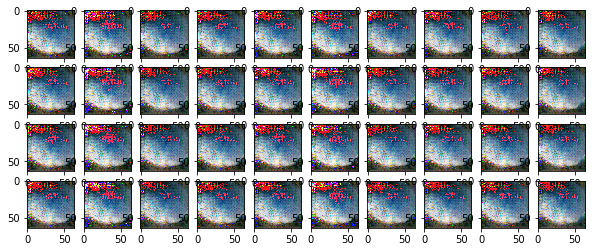

Step 49100: Generator Loss: 6.650482, Discriminator Loss: 0.000868
Step 49200: Generator Loss: 6.359468, Discriminator Loss: 0.000896
Step 49300: Generator Loss: 6.699974, Discriminator Loss: 0.000688
Step 49400: Generator Loss: 7.294114, Discriminator Loss: 0.000376
Step 49500: Generator Loss: 6.221774, Discriminator Loss: 0.026359
Step 49600: Generator Loss: 4.857359, Discriminator Loss: 0.444612
Step 49700: Generator Loss: 7.965376, Discriminator Loss: 0.006954
Step 49800: Generator Loss: 6.501257, Discriminator Loss: 0.003653
Step 49900: Generator Loss: 6.418273, Discriminator Loss: 0.002974
Step 50000: Generator Loss: 8.134615, Discriminator Loss: 0.002736


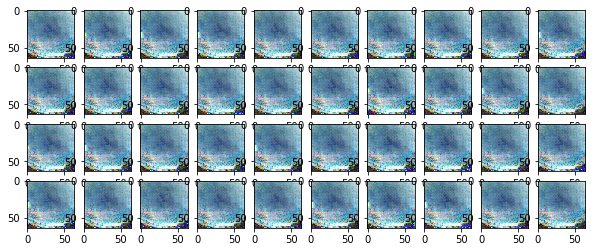

Step 50100: Generator Loss: 12.297319, Discriminator Loss: 0.000011
Step 50200: Generator Loss: 7.480504, Discriminator Loss: 0.000418
Step 50300: Generator Loss: 9.696243, Discriminator Loss: 0.000077
Step 50400: Generator Loss: 14.421225, Discriminator Loss: 0.000141
Step 50500: Generator Loss: 6.903314, Discriminator Loss: 0.000526
Step 50600: Generator Loss: 5.174921, Discriminator Loss: 0.003273
Step 50700: Generator Loss: 7.408375, Discriminator Loss: 0.027832
Step 50800: Generator Loss: 5.842119, Discriminator Loss: 0.001486
Step 50900: Generator Loss: 8.205643, Discriminator Loss: 0.000199
Step 51000: Generator Loss: 7.040540, Discriminator Loss: 0.000758


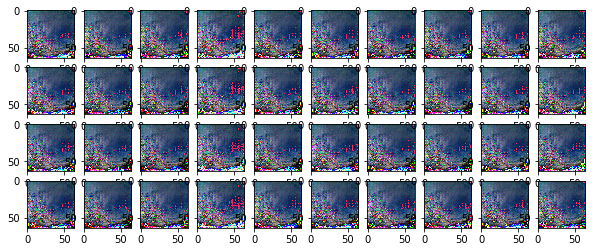

Step 51100: Generator Loss: 10.179323, Discriminator Loss: 0.000214
Step 51200: Generator Loss: 7.460316, Discriminator Loss: 0.000551
Step 51300: Generator Loss: 11.182987, Discriminator Loss: 0.000118
Step 51400: Generator Loss: 7.541340, Discriminator Loss: 0.002070
Step 51500: Generator Loss: 6.474511, Discriminator Loss: 0.000826
Step 51600: Generator Loss: 7.166944, Discriminator Loss: 0.000530
Step 51700: Generator Loss: 5.396012, Discriminator Loss: 0.002768
Step 51800: Generator Loss: 6.413943, Discriminator Loss: 0.001352
Step 51900: Generator Loss: 4.994517, Discriminator Loss: 0.003786
Step 52000: Generator Loss: 6.075827, Discriminator Loss: 0.001291


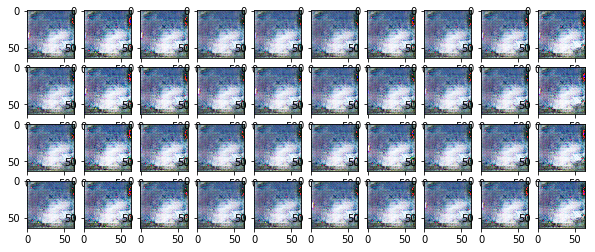

Step 52100: Generator Loss: 6.844974, Discriminator Loss: 0.018599
Step 52200: Generator Loss: 5.941052, Discriminator Loss: 0.001565
Step 52300: Generator Loss: 9.791471, Discriminator Loss: 0.000253
Step 52400: Generator Loss: 5.320469, Discriminator Loss: 0.002618
Step 52500: Generator Loss: 7.271569, Discriminator Loss: 0.000349
Step 52600: Generator Loss: 5.612724, Discriminator Loss: 0.013695
Step 52700: Generator Loss: 2.259733, Discriminator Loss: 0.056055
Step 52800: Generator Loss: 6.107326, Discriminator Loss: 0.001936
Step 52900: Generator Loss: 7.009133, Discriminator Loss: 0.000542
Step 53000: Generator Loss: 5.809589, Discriminator Loss: 0.001945


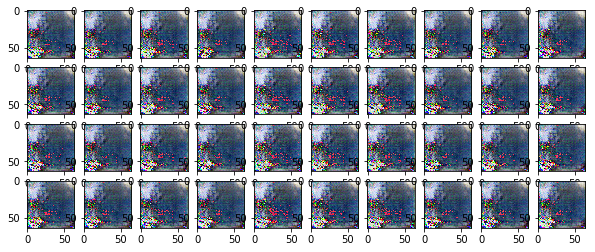

Step 53100: Generator Loss: 5.875940, Discriminator Loss: 0.002856
Step 53200: Generator Loss: 9.580801, Discriminator Loss: 0.005131
Step 53300: Generator Loss: 7.351759, Discriminator Loss: 0.000554
Step 53400: Generator Loss: 10.701509, Discriminator Loss: 0.000012
Step 53500: Generator Loss: 15.630574, Discriminator Loss: 0.000070
Step 53600: Generator Loss: 7.986648, Discriminator Loss: 0.000180
Step 53700: Generator Loss: 6.239477, Discriminator Loss: 0.002177
Step 53800: Generator Loss: 4.831354, Discriminator Loss: 0.004243
Step 53900: Generator Loss: 6.688417, Discriminator Loss: 0.002968
Step 54000: Generator Loss: 5.313550, Discriminator Loss: 0.002846


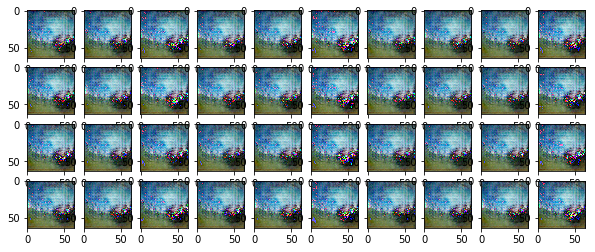

Step 54100: Generator Loss: 6.750951, Discriminator Loss: 0.001060
Step 54200: Generator Loss: 6.799942, Discriminator Loss: 0.397991
Step 54300: Generator Loss: 6.075029, Discriminator Loss: 0.001470
Step 54400: Generator Loss: 7.172711, Discriminator Loss: 0.034088
Step 54500: Generator Loss: 6.460352, Discriminator Loss: 0.000797
Step 54600: Generator Loss: 6.579787, Discriminator Loss: 0.001078
Step 54700: Generator Loss: 6.771965, Discriminator Loss: 0.013216
Step 54800: Generator Loss: 6.781273, Discriminator Loss: 0.155208
Step 54900: Generator Loss: 7.280161, Discriminator Loss: 0.014778
Step 55000: Generator Loss: 6.266654, Discriminator Loss: 0.000965


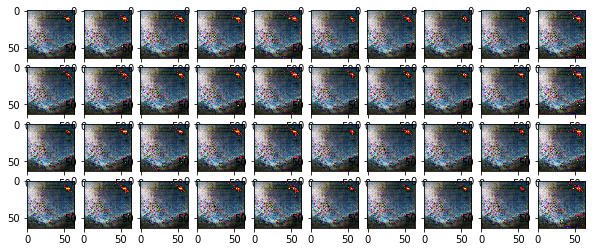

Step 55100: Generator Loss: 9.048138, Discriminator Loss: 0.022309
Step 55200: Generator Loss: 7.009610, Discriminator Loss: 0.000505
Step 55300: Generator Loss: 5.685078, Discriminator Loss: 0.001954
Step 55400: Generator Loss: 7.322794, Discriminator Loss: 0.002422
Step 55500: Generator Loss: 5.280067, Discriminator Loss: 0.002875
Step 55600: Generator Loss: 7.187180, Discriminator Loss: 0.000529
Step 55700: Generator Loss: 6.739577, Discriminator Loss: 0.000671
Step 55800: Generator Loss: 8.805155, Discriminator Loss: 0.000078
Step 55900: Generator Loss: 6.241939, Discriminator Loss: 0.001344
Step 56000: Generator Loss: 5.686714, Discriminator Loss: 0.001872


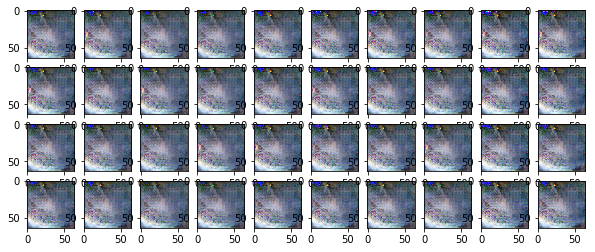

Step 56100: Generator Loss: 5.528088, Discriminator Loss: 0.002576
Step 56200: Generator Loss: 7.907493, Discriminator Loss: 0.003546
Step 56300: Generator Loss: 18.073423, Discriminator Loss: 0.000037
Step 56400: Generator Loss: 8.406083, Discriminator Loss: 0.000181
Step 56500: Generator Loss: 7.332788, Discriminator Loss: 0.099315
Step 56600: Generator Loss: 8.002957, Discriminator Loss: 0.000190
Step 56700: Generator Loss: 6.907121, Discriminator Loss: 0.000639
Step 56800: Generator Loss: 6.869723, Discriminator Loss: 0.000564
Step 56900: Generator Loss: 7.618090, Discriminator Loss: 0.000261
Step 57000: Generator Loss: 7.367312, Discriminator Loss: 0.001737


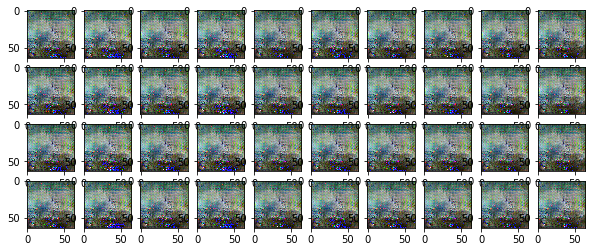

Step 57100: Generator Loss: 8.424874, Discriminator Loss: 0.000131
Step 57200: Generator Loss: 6.023190, Discriminator Loss: 0.001246
Step 57300: Generator Loss: 7.261174, Discriminator Loss: 0.000372
Step 57400: Generator Loss: 6.369649, Discriminator Loss: 0.000908
Step 57500: Generator Loss: 6.800311, Discriminator Loss: 0.000740
Step 57600: Generator Loss: 8.226429, Discriminator Loss: 0.000152
Step 57700: Generator Loss: 6.350358, Discriminator Loss: 0.000881
Step 57800: Generator Loss: 2.518700, Discriminator Loss: 0.051175
Step 57900: Generator Loss: 7.843733, Discriminator Loss: 0.000212
Step 58000: Generator Loss: 7.983924, Discriminator Loss: 0.000964


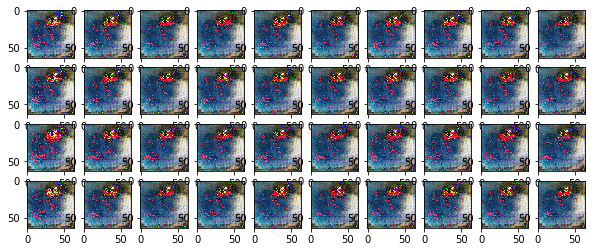

Step 58100: Generator Loss: 7.307992, Discriminator Loss: 0.000373
Step 58200: Generator Loss: 7.175402, Discriminator Loss: 0.000425
Step 58300: Generator Loss: 5.560717, Discriminator Loss: 0.006211
Step 58400: Generator Loss: 6.766548, Discriminator Loss: 0.000652
Step 58500: Generator Loss: 9.715508, Discriminator Loss: 0.000036
Step 58600: Generator Loss: 5.009463, Discriminator Loss: 0.003655
Step 58700: Generator Loss: 6.870612, Discriminator Loss: 0.000661
Step 58800: Generator Loss: 6.033721, Discriminator Loss: 0.001602
Step 58900: Generator Loss: 6.868524, Discriminator Loss: 0.000570
Step 59000: Generator Loss: 9.806606, Discriminator Loss: 0.000081


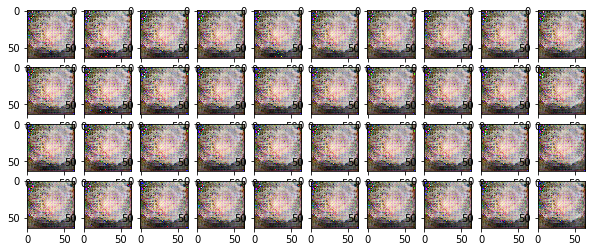

Step 59100: Generator Loss: 6.756105, Discriminator Loss: 0.000621
Step 59200: Generator Loss: 8.000349, Discriminator Loss: 0.000172
Step 59300: Generator Loss: 6.810675, Discriminator Loss: 0.000685
Step 59400: Generator Loss: 6.610829, Discriminator Loss: 0.000720
Step 59500: Generator Loss: 18.192112, Discriminator Loss: 0.000326
Step 59600: Generator Loss: 8.004997, Discriminator Loss: 0.000247
Step 59700: Generator Loss: 9.883151, Discriminator Loss: 0.000026
Step 59800: Generator Loss: 5.947771, Discriminator Loss: 0.001418
Step 59900: Generator Loss: 3.805078, Discriminator Loss: 0.011813
Step 60000: Generator Loss: 6.201399, Discriminator Loss: 0.001377


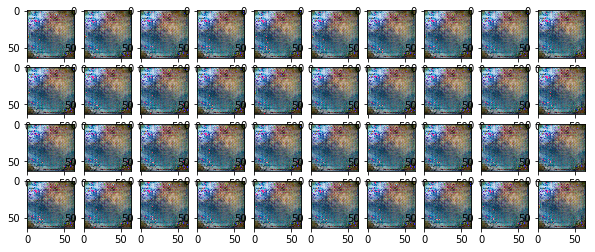

Step 60100: Generator Loss: 4.656139, Discriminator Loss: 0.006406
Step 60200: Generator Loss: 8.191862, Discriminator Loss: 0.000148
Step 60300: Generator Loss: 12.675550, Discriminator Loss: 0.001804
Step 60400: Generator Loss: 7.542337, Discriminator Loss: 0.000349
Step 60500: Generator Loss: 7.672782, Discriminator Loss: 0.000344
Step 60600: Generator Loss: 6.443439, Discriminator Loss: 0.000899
Step 60700: Generator Loss: 8.918742, Discriminator Loss: 0.000069
Step 60800: Generator Loss: 5.844748, Discriminator Loss: 0.001648
Step 60900: Generator Loss: 6.381472, Discriminator Loss: 0.001386
Step 61000: Generator Loss: 6.549259, Discriminator Loss: 0.000810


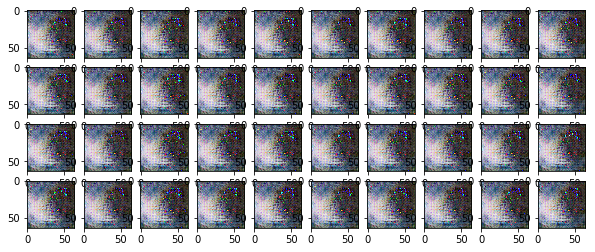

Step 61100: Generator Loss: 7.443190, Discriminator Loss: 0.007878
Step 61200: Generator Loss: 5.930231, Discriminator Loss: 0.001364
Step 61300: Generator Loss: 7.790643, Discriminator Loss: 0.000219
Step 61400: Generator Loss: 5.979244, Discriminator Loss: 0.001391
Step 61500: Generator Loss: 7.959841, Discriminator Loss: 1.817442
Step 61600: Generator Loss: 7.154461, Discriminator Loss: 0.000403
Step 61700: Generator Loss: 9.236809, Discriminator Loss: 0.000060
Step 61800: Generator Loss: 6.906967, Discriminator Loss: 0.000528
Step 61900: Generator Loss: 8.045976, Discriminator Loss: 0.000161
Step 62000: Generator Loss: 7.370474, Discriminator Loss: 0.000339


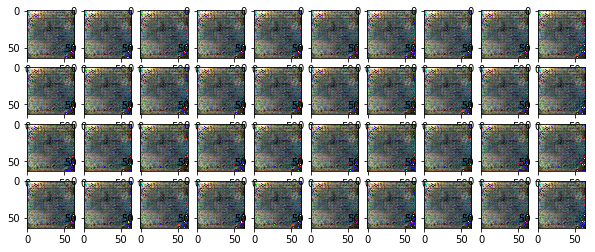

Step 62100: Generator Loss: 9.533165, Discriminator Loss: 0.000043
Step 62200: Generator Loss: 7.172737, Discriminator Loss: 0.000445
Step 62300: Generator Loss: 7.544199, Discriminator Loss: 0.000279
Step 62400: Generator Loss: 7.836393, Discriminator Loss: 0.000210
Step 62500: Generator Loss: 7.935108, Discriminator Loss: 0.000292
Step 62600: Generator Loss: 4.987719, Discriminator Loss: 0.003440
Step 62700: Generator Loss: 5.096569, Discriminator Loss: 0.004398
Step 62800: Generator Loss: 5.390832, Discriminator Loss: 0.002530
Step 62900: Generator Loss: 6.161390, Discriminator Loss: 0.001175
Step 63000: Generator Loss: 8.357204, Discriminator Loss: 0.125734


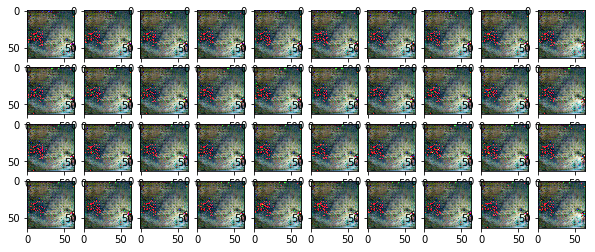

Step 63100: Generator Loss: 7.181649, Discriminator Loss: 0.000428
Step 63200: Generator Loss: 5.948358, Discriminator Loss: 0.001632
Step 63300: Generator Loss: 7.131451, Discriminator Loss: 0.000478
Step 63400: Generator Loss: 5.423881, Discriminator Loss: 0.002604
Step 63500: Generator Loss: 8.600863, Discriminator Loss: 0.000244
Step 63600: Generator Loss: 20.466171, Discriminator Loss: 0.000384
Step 63700: Generator Loss: 8.676368, Discriminator Loss: 0.001509
Step 63800: Generator Loss: 7.590422, Discriminator Loss: 0.003368
Step 63900: Generator Loss: 4.518839, Discriminator Loss: 0.025872
Step 64000: Generator Loss: 12.734827, Discriminator Loss: 0.012180


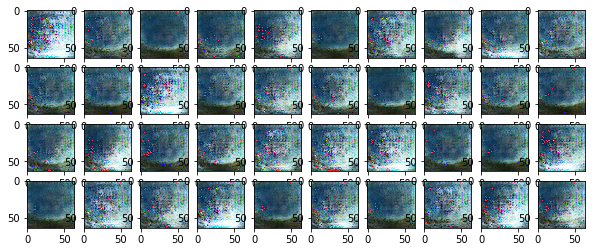

Step 64100: Generator Loss: 5.962023, Discriminator Loss: 0.001512
Step 64200: Generator Loss: 8.514557, Discriminator Loss: 0.000571
Step 64300: Generator Loss: 6.608773, Discriminator Loss: 0.004451
Step 64400: Generator Loss: 10.037961, Discriminator Loss: 0.000328
Step 64500: Generator Loss: 6.920452, Discriminator Loss: 0.017859
Step 64600: Generator Loss: 13.475246, Discriminator Loss: 0.000490
Step 64700: Generator Loss: 5.178493, Discriminator Loss: 0.024089
Step 64800: Generator Loss: 5.154532, Discriminator Loss: 0.005879
Step 64900: Generator Loss: 6.389625, Discriminator Loss: 0.002692
Step 65000: Generator Loss: 6.952165, Discriminator Loss: 0.001059


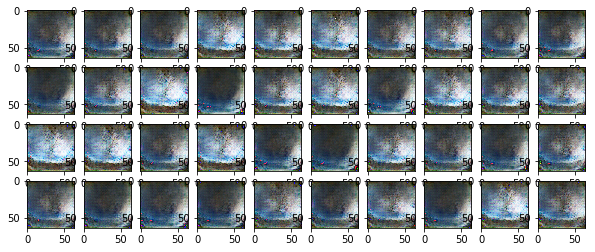

Step 65100: Generator Loss: 6.464801, Discriminator Loss: 0.001242
Step 65200: Generator Loss: 7.620165, Discriminator Loss: 0.002160
Step 65300: Generator Loss: 9.281736, Discriminator Loss: 0.000150
Step 65400: Generator Loss: 7.181160, Discriminator Loss: 0.034974
Step 65500: Generator Loss: 15.232283, Discriminator Loss: 0.000320
Step 65600: Generator Loss: 8.011482, Discriminator Loss: 0.053145
Step 65700: Generator Loss: 7.566113, Discriminator Loss: 0.047557
Step 65800: Generator Loss: 6.018241, Discriminator Loss: 0.008937
Step 65900: Generator Loss: 3.925068, Discriminator Loss: 0.019865
Step 66000: Generator Loss: 5.042135, Discriminator Loss: 0.009494


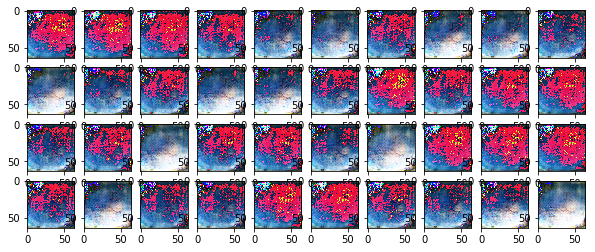

Step 66100: Generator Loss: 7.953609, Discriminator Loss: 0.001497
Step 66200: Generator Loss: 7.018236, Discriminator Loss: 0.000512
Step 66300: Generator Loss: 4.720909, Discriminator Loss: 0.004683
Step 66400: Generator Loss: 10.545527, Discriminator Loss: 0.000016
Step 66500: Generator Loss: 6.784380, Discriminator Loss: 0.001122
Step 66600: Generator Loss: 6.774360, Discriminator Loss: 0.001398
Step 66700: Generator Loss: 6.103051, Discriminator Loss: 0.001375
Step 66800: Generator Loss: 8.223537, Discriminator Loss: 0.001414
Step 66900: Generator Loss: 6.121880, Discriminator Loss: 0.001823
Step 67000: Generator Loss: 6.765969, Discriminator Loss: 0.000611


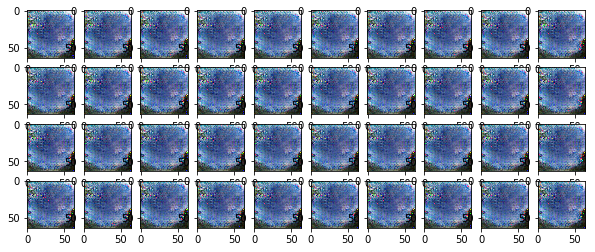

Step 67100: Generator Loss: 6.878691, Discriminator Loss: 0.000519
Step 67200: Generator Loss: 11.074572, Discriminator Loss: 0.000010
Step 67300: Generator Loss: 7.139970, Discriminator Loss: 0.000611
Step 67400: Generator Loss: 7.918769, Discriminator Loss: 0.013819
Step 67500: Generator Loss: 8.172023, Discriminator Loss: 0.000422
Step 67600: Generator Loss: 7.553946, Discriminator Loss: 0.000327
Step 67700: Generator Loss: 7.736776, Discriminator Loss: 0.000238
Step 67800: Generator Loss: 6.873702, Discriminator Loss: 0.000543
Step 67900: Generator Loss: 7.690541, Discriminator Loss: 0.000233
Step 68000: Generator Loss: 8.126605, Discriminator Loss: 0.000243


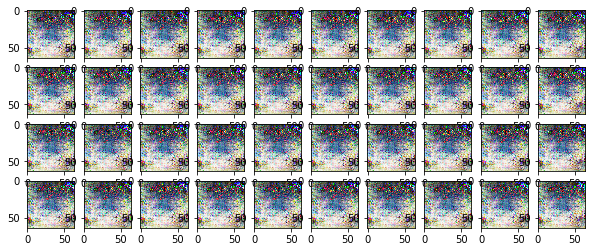

Step 68100: Generator Loss: 6.734948, Discriminator Loss: 0.000624
Step 68200: Generator Loss: 6.289815, Discriminator Loss: 0.000938
Step 68300: Generator Loss: 9.131503, Discriminator Loss: 0.000126
Step 68400: Generator Loss: 7.008438, Discriminator Loss: 0.000592
Step 68500: Generator Loss: 7.483862, Discriminator Loss: 0.002472
Step 68600: Generator Loss: 6.525089, Discriminator Loss: 0.000771
Step 68700: Generator Loss: 6.362241, Discriminator Loss: 0.000887
Step 68800: Generator Loss: 9.276704, Discriminator Loss: 0.000062
Step 68900: Generator Loss: 4.554637, Discriminator Loss: 0.005691
Step 69000: Generator Loss: 6.117089, Discriminator Loss: 0.001194


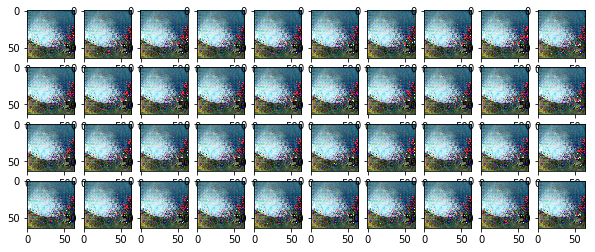

Step 69100: Generator Loss: 7.433104, Discriminator Loss: 0.000362
Step 69200: Generator Loss: 6.000887, Discriminator Loss: 0.001871
Step 69300: Generator Loss: 7.224404, Discriminator Loss: 0.000382
Step 69400: Generator Loss: 6.984242, Discriminator Loss: 0.000467
Step 69500: Generator Loss: 8.216129, Discriminator Loss: 0.000206
Step 69600: Generator Loss: 6.967014, Discriminator Loss: 0.000474
Step 69700: Generator Loss: 7.799834, Discriminator Loss: 0.000210
Step 69800: Generator Loss: 6.553703, Discriminator Loss: 0.001446
Step 69900: Generator Loss: 7.503973, Discriminator Loss: 0.000279
Step 70000: Generator Loss: 6.688780, Discriminator Loss: 0.000640


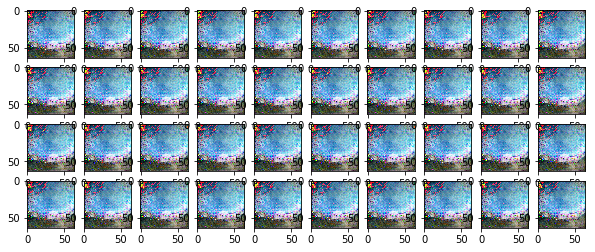

Step 70100: Generator Loss: 6.730642, Discriminator Loss: 0.000604
Step 70200: Generator Loss: 7.848641, Discriminator Loss: 0.000199
Step 70300: Generator Loss: 7.914838, Discriminator Loss: 0.000188
Step 70400: Generator Loss: 4.759791, Discriminator Loss: 0.005526
Step 70500: Generator Loss: 11.659512, Discriminator Loss: 0.000005
Step 70600: Generator Loss: 11.108725, Discriminator Loss: 0.000033
Step 70700: Generator Loss: 6.541543, Discriminator Loss: 0.000802
Step 70800: Generator Loss: 7.849351, Discriminator Loss: 0.040042
Step 70900: Generator Loss: 5.637404, Discriminator Loss: 0.010798
Step 71000: Generator Loss: 6.772379, Discriminator Loss: 0.000582


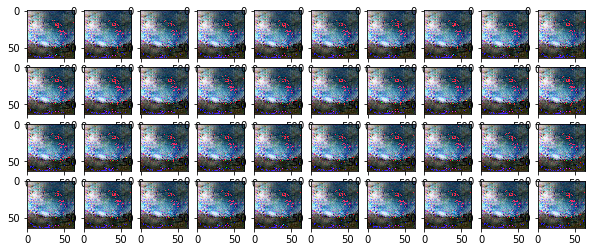

Step 71100: Generator Loss: 10.985654, Discriminator Loss: 0.000009
Step 71200: Generator Loss: 6.204077, Discriminator Loss: 0.001045
Step 71300: Generator Loss: 6.924586, Discriminator Loss: 0.000522
Step 71400: Generator Loss: 6.875993, Discriminator Loss: 0.000528
Step 71500: Generator Loss: 17.032661, Discriminator Loss: 0.000010
Step 71600: Generator Loss: 5.978020, Discriminator Loss: 0.001393
Step 71700: Generator Loss: 5.304717, Discriminator Loss: 0.002843
Step 71800: Generator Loss: 7.048880, Discriminator Loss: 0.000460
Step 71900: Generator Loss: 7.020020, Discriminator Loss: 0.000480
Step 72000: Generator Loss: 6.560967, Discriminator Loss: 0.000712


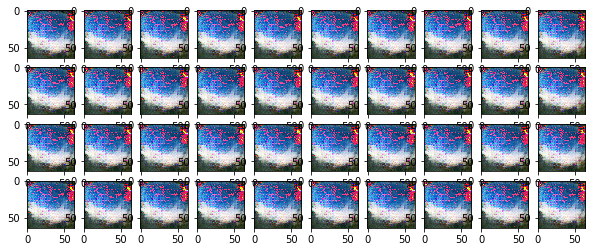

Step 72100: Generator Loss: 6.254768, Discriminator Loss: 0.001026
Step 72200: Generator Loss: 10.841866, Discriminator Loss: 0.000014
Step 72300: Generator Loss: 6.416828, Discriminator Loss: 0.000831
Step 72400: Generator Loss: 6.511490, Discriminator Loss: 0.000762
Step 72500: Generator Loss: 7.243505, Discriminator Loss: 0.000361
Step 72600: Generator Loss: 7.499771, Discriminator Loss: 0.000455
Step 72700: Generator Loss: 7.884211, Discriminator Loss: 0.000220
Step 72800: Generator Loss: 10.042847, Discriminator Loss: 0.000086
Step 72900: Generator Loss: 25.234005, Discriminator Loss: 0.000000
Step 73000: Generator Loss: 18.133682, Discriminator Loss: 0.264675


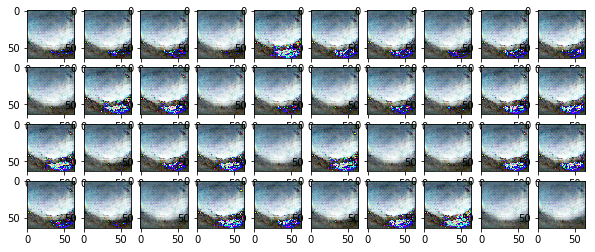

Step 73100: Generator Loss: 6.844625, Discriminator Loss: 0.000925
Step 73200: Generator Loss: 6.684256, Discriminator Loss: 0.001117
Step 73300: Generator Loss: 7.722035, Discriminator Loss: 0.017919
Step 73400: Generator Loss: 6.397323, Discriminator Loss: 0.002758
Step 73500: Generator Loss: 6.260756, Discriminator Loss: 0.001237
Step 73600: Generator Loss: 6.853214, Discriminator Loss: 0.000611
Step 73700: Generator Loss: 7.255704, Discriminator Loss: 0.000369
Step 73800: Generator Loss: 6.452460, Discriminator Loss: 0.001312
Step 73900: Generator Loss: 5.262398, Discriminator Loss: 0.002930
Step 74000: Generator Loss: 6.632532, Discriminator Loss: 0.000661


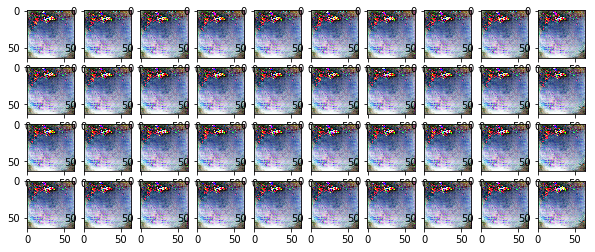

Step 74100: Generator Loss: 6.200243, Discriminator Loss: 0.001034
Step 74200: Generator Loss: 8.009933, Discriminator Loss: 0.000180
Step 74300: Generator Loss: 5.672172, Discriminator Loss: 0.002226
Step 74400: Generator Loss: 5.628763, Discriminator Loss: 0.002548
Step 74500: Generator Loss: 5.980819, Discriminator Loss: 0.001576
Step 74600: Generator Loss: 6.849079, Discriminator Loss: 0.000553
Step 74700: Generator Loss: 7.642632, Discriminator Loss: 0.000244
Step 74800: Generator Loss: 7.120018, Discriminator Loss: 0.000464
Step 74900: Generator Loss: 7.324266, Discriminator Loss: 0.000332
Step 75000: Generator Loss: 6.756836, Discriminator Loss: 0.000951


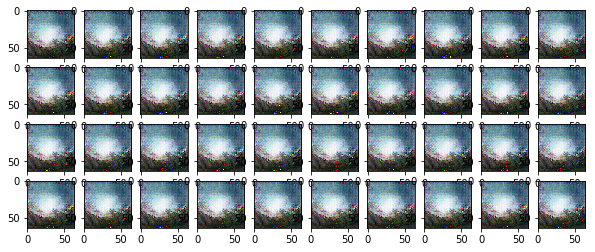

Step 75100: Generator Loss: 8.324017, Discriminator Loss: 0.000247
Step 75200: Generator Loss: 7.510221, Discriminator Loss: 0.000282
Step 75300: Generator Loss: 8.298573, Discriminator Loss: 0.000128
Step 75400: Generator Loss: 7.049893, Discriminator Loss: 0.001545


In [ ]:
saver = tf.train.Saver()

# Start training
with tf.Session() as sess:

    # Run the initializer
    sess.run(init)
    sess.run(iterator.initializer)
    for i in range(1, num_steps+1):
        # Prepare Input Data
        # Get the next batch of MNIST data (only images are needed, not labels)
        batch_x, _ = sess.run(next_element)
        batch_x = np.reshape(batch_x, newshape=[-1, 64, 64, 3])
        # Generate noise to feed to the generator
        z = np.random.normal(-1., 1., size=[batch_size, n_noise])

        # Prepare Targets (Real image: 1, Fake image: 0)
        # The first half of data fed to the generator are real images,
        # the other half are fake images (coming from the generator).
        batch_disc_y = np.concatenate(
            [np.ones([batch_size]), np.zeros([batch_size])], axis=0)
        # Generator tries to fool the discriminator, thus targets are 1.
        batch_gen_y = np.ones([batch_size])

        # Training
        feed_dict = {real_input_image: batch_x, input_noise: z,
                     dis_target: batch_disc_y, gen_target: batch_gen_y}
        
#         print("step: %i" %i)

        for xtra in range(0, 1):
            _ = sess.run([train_gen], feed_dict=feed_dict)
        
        _, _, gl, dl = sess.run([train_gen, train_dis, gen_loss, dis_loss],
                                feed_dict=feed_dict)
#         _, _, gl, dl = sess.run([train_gen, train_dis, gen_loss, dis_loss],
#                                 feed_dict=feed_dict)
        if i % 100 == 0 or i == 1:
            print('Step %i: Generator Loss: %f, Discriminator Loss: %f' % (i, gl, dl))
            
        if i % 1000 == 0:
            f, a = plt.subplots(4, 10, figsize=(10, 4))
            for b in range(10):
                # Noise input.
                z_test = np.random.uniform(-1., 1., size=[4, n_noise])
                g_test = sess.run(generator, feed_dict={input_noise: z_test})
                for j in range(4):
                    # Generate image from noise. Extend to 3 channels for matplot figure.
                    img = np.reshape(np.repeat(g_test[j][:, :, np.newaxis], 1, axis=2),
                                     newshape=(64, 64, 3))
                    a[j][b].imshow((img*255).astype(np.uint8))
            f.show()
            plt.show()

    # Save the variable to disk
    
    save_path = saver.save(sess, "saved_dcgan.ckpt")
    print("Model saved in path: %s" % save_path)
    
    # Generate images from noise, using the generator network.
    f, a = plt.subplots(4, 10, figsize=(10, 4))
    for i in range(10):
        # Noise input.
        z = np.random.uniform(-1., 1., size=[4, n_noise])
        g = sess.run(generator, feed_dict={input_noise: z})
        for j in range(4):
            # Generate image from noise. Extend to 3 channels for matplot figure.
            img = np.reshape(np.repeat(g[j][:, :, np.newaxis], 1, axis=2),
                             newshape=(64, 64, 3))
            a[j][i].imshow(img)

    f.show()
    plt.show()